<a href="https://colab.research.google.com/github/RimaDas89/Internship/blob/main/BANK_MARKETING.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# BANK MARKETING: Predicting Whether The Customer Will Subscribe To Term Deposit (FIXED DEPOSIT) or not.

![Digital-marketing-for-banking-sector-with-more-effective-seo-services-Illusions-Brand-scaled.jpg](attachment:Digital-marketing-for-banking-sector-with-more-effective-seo-services-Illusions-Brand-scaled.jpg)

#### Business Use Case:

There has been a revenue decline for a Portuguese bank and they would like to know what actions to take. After investigation, they found out that the root cause is that their clients are not depositing as frequently as before. Knowing that term deposits allow banks to hold onto a deposit for a specific amount of time, so banks can invest in higher gain financial products to make a profit. In addition, banks also hold better chance to persuade term deposit clients into buying other products such as funds or insurance to further increase their revenues. As a result, the Portuguese bank would like to identify existing clients that have higher chance to subscribe for a term deposit and focus marketing efforts on such clients.

#### Project Description:

Your client is a retail banking institution. Term deposits are a major source of income for a bank. A term deposit is a cash investment held at a financial institution. Your money is invested for an agreed rate of interest over a fixed amount of time, or term. The bank has various outreach plans to sell term deposits to their customers such as email marketing, advertisements, telephonic marketing and digital marketing. Telephonic marketing campaigns still remain one of the most effective way to reach out to people. However, they require huge investment as large call centers are hired to actually execute these campaigns. Hence, it is crucial to identify the customers most likely to convert beforehand so that they can be specifically targeted via call.
You are provided with the client data such as : age of the client, their job type, their marital status, etc. Along with the client data, you are also provided with the information of the call such as the duration of the call, day and month of the call, etc. Given this information, your task is to predict if the client will subscribe to term deposit.

#### About The Dataset:
The dataset is related with direct marketing campaigns (phone calls) of a Portuguese banking institution. The classification goal of this dataset is to predict if the client or the customer of polish banking institution will subscribe a term deposit product of the bank or not.

You are provided with following 2 files:
 1. train.csv : Use this dataset to train the model. This file contains all the client and call details as well as the target variable “subscribed”. You have to train your model using this file.
2. test.csv : Use the trained model to predict whether a new set of clients will subscribe the term deposit.

#### Dataset Attributes:
Here is the description of all the variables:
•	Variable: Definition
•	ID: Unique client ID
•	age: Age of the client
•	job: Type of job
•	marital: Marital status of the client
•	education: Education level
•	default: Credit in default.
•	housing: Housing loan
•	loan: Personal loan
•	contact: Type of communication
•	month: Contact month
•	day_of_week: Day of week of contact
•	duration: Contact duration
•	campaign: number of contacts performed during this campaign to the client
•	pdays: number of days that passed by after the client was last contacted
•	previous: number of contacts performed before this campaign
•	poutcome: outcome of the previous marketing campaign

#### Output variable (desired target):
* **Subscribed (target):** has the client subscribed a term deposit? (YES/NO)

## 1. Importing Libraries

In [ ]:
# Analyse & Manipulate Data
import pandas as pd
import numpy as np

# Data Visulaization
import matplotlib.pyplot as plt
import seaborn as sns

# Processor, Scaler, Sampler
from scipy.stats import zscore
from sklearn.preprocessing import LabelEncoder, RobustScaler
from imblearn.over_sampling import SMOTE

# Classifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier,ExtraTreesClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB

# Model Evaluation & Selection
from sklearn.model_selection import train_test_split, RandomizedSearchCV,cross_val_score, cross_val_predict
from sklearn import metrics
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score,recall_score, f1_score
from sklearn.metrics import roc_auc_score,roc_curve

#Saving Model
import pickle

# Prevent WARNINGS
import warnings
warnings.filterwarnings('ignore')

## 2. Importing Data & Analyse

In [ ]:
train = pd.read_csv("C:\\Users\\Rima Das\\Downloads\\BanK\\BANK MARKETING\\termdeposit_train.csv")
train

,ID,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,subscribed
0,26110,56,admin.,married,unknown,no,1933,no,no,telephone,19,nov,44,2,-1,0,unknown,no
1,40576,31,unknown,married,secondary,no,3,no,no,cellular,20,jul,91,2,-1,0,unknown,no
2,15320,27,services,married,secondary,no,891,yes,no,cellular,18,jul,240,1,-1,0,unknown,no
3,43962,57,management,divorced,tertiary,no,3287,no,no,cellular,22,jun,867,1,84,3,success,yes
4,29842,31,technician,married,secondary,no,119,yes,no,cellular,4,feb,380,1,-1,0,unknown,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31642,36483,29,management,single,tertiary,no,0,yes,no,cellular,12,may,116,2,-1,0,unknown,no
31643,40178,53,management,divorced,tertiary,no,380,no,yes,cellular,5,jun,438,2,-1,0,unknown,yes
31644,19710,32,management,single,tertiary,no,312,no,no,cellular,7,aug,37,3,-1,0,unknown,no
31645,38556,57,technician,married,secondary,no,225,yes,no,telephone,15,may,22,7,337,12,failure,no


In [ ]:
test= pd.read_csv("C:\\Users\\Rima Das\\Downloads\\BanK\\BANK MARKETING\\termdeposit_test.csv")
test

,ID,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome
0,38441,32,services,married,secondary,no,118,yes,no,cellular,15,may,20,6,-1,0,unknown
1,40403,78,retired,divorced,primary,no,2787,no,no,telephone,1,jul,372,1,-1,0,unknown
2,3709,31,self-employed,single,tertiary,no,144,yes,no,unknown,16,may,676,1,-1,0,unknown
3,37422,57,services,single,primary,no,3777,yes,no,telephone,13,may,65,2,-1,0,unknown
4,12527,45,blue-collar,divorced,secondary,no,-705,no,yes,unknown,3,jul,111,1,-1,0,unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13559,23465,39,management,married,tertiary,no,45,no,no,cellular,28,aug,148,4,-1,0,unknown
13560,11743,54,blue-collar,married,primary,no,2281,yes,no,unknown,20,jun,158,1,-1,0,unknown
13561,28292,35,retired,married,primary,no,285,yes,no,cellular,29,jan,136,1,-1,0,unknown
13562,45163,29,admin.,single,secondary,no,464,no,no,cellular,9,nov,208,2,91,3,success


## a. Data Inspection:

In [ ]:
train.head()

,ID,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,subscribed
0,26110,56,admin.,married,unknown,no,1933,no,no,telephone,19,nov,44,2,-1,0,unknown,no
1,40576,31,unknown,married,secondary,no,3,no,no,cellular,20,jul,91,2,-1,0,unknown,no
2,15320,27,services,married,secondary,no,891,yes,no,cellular,18,jul,240,1,-1,0,unknown,no
3,43962,57,management,divorced,tertiary,no,3287,no,no,cellular,22,jun,867,1,84,3,success,yes
4,29842,31,technician,married,secondary,no,119,yes,no,cellular,4,feb,380,1,-1,0,unknown,no


In [ ]:
test.head()

,ID,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome
0,38441,32,services,married,secondary,no,118,yes,no,cellular,15,may,20,6,-1,0,unknown
1,40403,78,retired,divorced,primary,no,2787,no,no,telephone,1,jul,372,1,-1,0,unknown
2,3709,31,self-employed,single,tertiary,no,144,yes,no,unknown,16,may,676,1,-1,0,unknown
3,37422,57,services,single,primary,no,3777,yes,no,telephone,13,may,65,2,-1,0,unknown
4,12527,45,blue-collar,divorced,secondary,no,-705,no,yes,unknown,3,jul,111,1,-1,0,unknown


## b. Data Description

In [ ]:
#checking Dimension of Train & Test data

print("In Train dataset we have {} rows & {} columns".format(*train.shape))
print("In Test dataset we have {} rows & {} columns".format(*test.shape))

In Train dataset we have 31647 rows & 18 columns
In Test dataset we have 13564 rows & 17 columns


In [ ]:
# Column Names in Train & Test Dataset

print("These are the columns present in TRAIN dataset: \n",train.columns)
print("\nThese are the columns present in TEST dataset: \n",test.columns)

These are the columns present in TRAIN dataset: 
 Index(['ID', 'age', 'job', 'marital', 'education', 'default', 'balance',
       'housing', 'loan', 'contact', 'day', 'month', 'duration', 'campaign',
       'pdays', 'previous', 'poutcome', 'subscribed'],
      dtype='object')

These are the columns present in TEST dataset: 
 Index(['ID', 'age', 'job', 'marital', 'education', 'default', 'balance',
       'housing', 'loan', 'contact', 'day', 'month', 'duration', 'campaign',
       'pdays', 'previous', 'poutcome'],
      dtype='object')


### `Observations:`

* **Train DataFrame:**
    * In Train dataset we can see that we have 31647 rows & 18 columns.

&nbsp;

* **Test DataFrame:**
    * In test Dataset we can see that we have 13564 rows & 17 columns.
    * Here 1 column is missing because thats our target/label column

## c. Understand Data Types:

In [ ]:
# Checking data information
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31647 entries, 0 to 31646
Data columns (total 18 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   ID          31647 non-null  int64 
 1   age         31647 non-null  int64 
 2   job         31647 non-null  object
 3   marital     31647 non-null  object
 4   education   31647 non-null  object
 5   default     31647 non-null  object
 6   balance     31647 non-null  int64 
 7   housing     31647 non-null  object
 8   loan        31647 non-null  object
 9   contact     31647 non-null  object
 10  day         31647 non-null  int64 
 11  month       31647 non-null  object
 12  duration    31647 non-null  int64 
 13  campaign    31647 non-null  int64 
 14  pdays       31647 non-null  int64 
 15  previous    31647 non-null  int64 
 16  poutcome    31647 non-null  object
 17  subscribed  31647 non-null  object
dtypes: int64(8), object(10)
memory usage: 4.3+ MB


In [ ]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13564 entries, 0 to 13563
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   ID         13564 non-null  int64 
 1   age        13564 non-null  int64 
 2   job        13564 non-null  object
 3   marital    13564 non-null  object
 4   education  13564 non-null  object
 5   default    13564 non-null  object
 6   balance    13564 non-null  int64 
 7   housing    13564 non-null  object
 8   loan       13564 non-null  object
 9   contact    13564 non-null  object
 10  day        13564 non-null  int64 
 11  month      13564 non-null  object
 12  duration   13564 non-null  int64 
 13  campaign   13564 non-null  int64 
 14  pdays      13564 non-null  int64 
 15  previous   13564 non-null  int64 
 16  poutcome   13564 non-null  object
dtypes: int64(8), object(9)
memory usage: 1.8+ MB


### `Observations`
* **Train Data**
    * We can see there are 18 columns including out Target column
    * Among 18 column, we have 8 columns contains integar values & 10 columns has object values
    * Our target column has object values
    * Memory Usage 4.3+ MB
    
&nbsp;

* **Test Data**
    * There are 17 columns no target column is there
    * out of 17 columns, 8 columns has integar values and 9 columns has object values.
    * Memory Usage: 1.8+ MB

## 3. Missing Values

In [ ]:
train.isnull().sum()

ID            0
age           0
job           0
marital       0
education     0
default       0
balance       0
housing       0
loan          0
contact       0
day           0
month         0
duration      0
campaign      0
pdays         0
previous      0
poutcome      0
subscribed    0
dtype: int64

In [ ]:
test.isnull().sum()

ID           0
age          0
job          0
marital      0
education    0
default      0
balance      0
housing      0
loan         0
contact      0
day          0
month        0
duration     0
campaign     0
pdays        0
previous     0
poutcome     0
dtype: int64

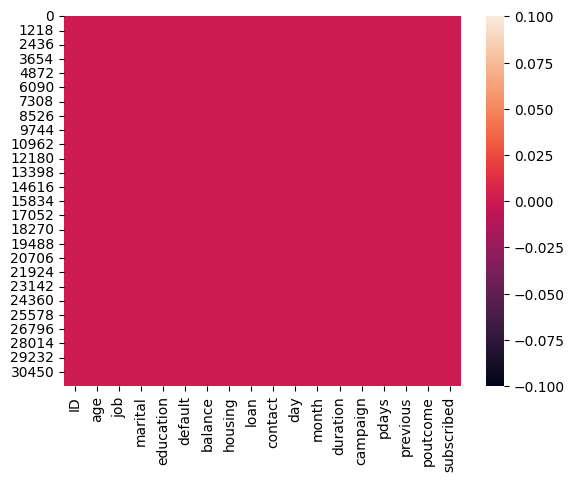

In [ ]:
#Visualizing it
sns.heatmap(train.isnull())
plt.show()

### `Observations:`
* There are no null values in our datasets(train and test)

## 4. Duplicate Values:

In [ ]:
print('We have {} duplicated values in our TRAIN datasets'.format(train.duplicated().sum()))
print('We have {} duplicated values in our TEST datasets'.format(test.duplicated().sum()))

We have 0 duplicated values in our TRAIN datasets
We have 0 duplicated values in our TEST datasets


### `Observations:`
* We have no duplicated values in both datasets

## 5. Separating Categorical and numerical columns

In [ ]:
#Seaparating Categrocial columns in train Dataframe
cat_col = train.select_dtypes(include='object').columns
print("Categorial columns in our train dataframe:\n",cat_col)

#Seaparating Numerical columns in train Dataframe
num_col = train.select_dtypes(include='int64').columns
print("\nNumerical columns in our train dataframe:\n",num_col)

Categorial columns in our train dataframe:
 Index(['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact',
       'month', 'poutcome', 'subscribed'],
      dtype='object')

Numerical columns in our train dataframe:
 Index(['ID', 'age', 'balance', 'day', 'duration', 'campaign', 'pdays',
       'previous'],
      dtype='object')


## 6. Statistical Summary

In [ ]:
#Statistical summary of Numerical colums
train.describe()

,ID,age,balance,day,duration,campaign,pdays,previous
count,31647.000000,31647.000000,31647.000000,31647.000000,31647.000000,31647.000000,31647.000000,31647.000000
mean,22563.972162,40.957247,1363.890258,15.835466,258.113534,2.765697,39.576042,0.574272
std,13075.936990,10.625134,3028.304293,8.337097,257.118973,3.113830,99.317592,2.422529
min,2.000000,18.000000,-8019.000000,1.000000,0.000000,1.000000,-1.000000,0.000000
25%,11218.000000,33.000000,73.000000,8.000000,104.000000,1.000000,-1.000000,0.000000
50%,22519.000000,39.000000,450.000000,16.000000,180.000000,2.000000,-1.000000,0.000000
75%,33879.500000,48.000000,1431.000000,21.000000,318.500000,3.000000,-1.000000,0.000000
max,45211.000000,95.000000,102127.000000,31.000000,4918.000000,63.000000,871.000000,275.000000


### `Observations:`

1. **ID**:
   - The 'ID' column appears to represent unique identifier values.
   - The range of 'ID' values starts from 2 and goes up to 45,211, suggesting that there are a total of 31,647 unique records in the dataset.
   
2. **age**:
   - The 'age' column represents the age of individuals.
   - The mean age in the dataset is approximately 40.96 years, with a minimum age of 18 years and a maximum age of 95 years.
   - The majority of individuals (at least 25%) fall in the age range of 33 to 48 years.
   
3. **balance**:
   - The 'balance' column likely represents the financial balance of individuals.
   - The mean balance is approximately 1363.89 units, with a wide range of values.
   - The distribution of 'balance' appears to be positively skewed, as the maximum value is significantly higher than the mean, indicating the presence of outliers.

4. **day**:
   - The 'day' column might represent the day of the month when the data was recorded.
   - The values in this column range from 1 to 31, suggesting that it could be associated with calendar days.

5. **duration**:
   - The 'duration' column may represent the duration of a contact or interaction.
   - The mean duration is approximately 258.11 seconds (or about 4.3 minutes).
   - The maximum duration is considerably higher at 4918 seconds, indicating the presence of long-duration interactions.

6. **campaign**:
   - The 'campaign' column likely represents the number of contacts made during a marketing campaign.
   - On average, individuals were contacted approximately 2.77 times during a campaign.
   - The maximum number of campaign contacts for an individual is 63, suggesting some extreme values.

7. **pdays**:
   - The 'pdays' column may indicate the number of days since the last contact.
   - The majority of values in this column appear to be -1, which might represent that the client was not previously contacted.
   - The maximum value is 871, suggesting a significant time gap for some clients between contacts.

8. **previous**:
   - The 'previous' column may represent the number of previous marketing contacts.
   - On average, individuals have had approximately 0.57 previous contacts.
   - The maximum number of previous contacts is 275, indicating that some individuals have been contacted multiple times in previous campaigns.

These observations provide an initial understanding of the TRAIN dataset's numerical features, including central tendencies, spreads, and potential outliers. Further data analysis and preprocessing may be required to gain deeper insights and prepare the data for modeling or analysis.

In [ ]:
#Statistical Summary of Categorical column
train.describe(include='object')

,job,marital,education,default,housing,loan,contact,month,poutcome,subscribed
count,31647,31647,31647,31647,31647,31647,31647,31647,31647,31647
unique,12,3,4,2,2,2,3,12,4,2
top,blue-collar,married,secondary,no,yes,no,cellular,may,unknown,no
freq,6842,19095,16224,31062,17584,26516,20423,9669,25929,27932


### `Observations:`

1. **job**:
   - The 'job' column represents the occupation or job type of individuals.
   - There are 12 unique job categories in the dataset.
   - The most common job category is 'blue-collar' with a frequency of 6,842 individuals.

2. **marital**:
   - The 'marital' column represents the marital status of individuals.
   - There are 3 unique marital status categories.
   - The majority of individuals are 'married,' with a frequency of 19,095.

3. **education**:
   - The 'education' column represents the education level of individuals.
   - There are 4 unique education categories.
   - 'Secondary' education is the most common, with 16,224 individuals having this education level.

4. **default**:
   - The 'default' column likely indicates whether individuals have credit in default.
   - There are 2 unique values: 'no' and 'yes.'
   - The majority of individuals (31,062) do not have credit in default.

5. **housing**:
   - The 'housing' column may indicate whether individuals have housing loans.
   - There are 2 unique values: 'no' and 'yes.'
   - The majority of individuals (17,584) have housing loans.

6. **loan**:
   - The 'loan' column represents whether individuals have personal loans.
   - There are 2 unique values: 'no' and 'yes.'
   - Most individuals (26,516) do not have personal loans.

7. **contact**:
   - The 'contact' column may indicate the method of communication.
   - There are 3 unique contact methods: 'cellular,' 'telephone,' and 'unknown.'
   - The most common contact method is 'cellular' (20,423 individuals).

8. **month**:
   - The 'month' column represents the month in which contacts were made.
   - There are 12 unique months.
   - The most frequently used contact month is 'May' (9,669 individuals).

9. **poutcome**:
   - The 'poutcome' column might represent the outcome of a previous marketing campaign.
   - There are 4 unique outcomes: 'unknown,' 'failure,' 'other,' and 'success.'
   - The most common outcome is 'unknown' (25,929 individuals).

10. **subscribed**:
    - The 'subscribed' column likely represents whether individuals subscribed to a service or product.
    - There are 2 unique values: 'no' and 'yes.'
    - The majority of individuals (27,932) did not subscribe.

These observations provide insights into the distribution of categorical variables in the TRAIN dataset, including the most common categories and their frequencies. Understanding these categorical features is essential for further analysis and modeling.

## 7. Data Visualization:

### Exploring Target/ Label

In [ ]:
# Calculate value counts for 'subscribed' column
value_counts = train['subscribed'].value_counts()

# Calculate percentages
percentages = (value_counts / len(train)) * 100

# Combine value counts and percentages into a DataFrame
result_df = pd.DataFrame({'Count': value_counts, 'Percentage': percentages})

# Print the result DataFrame
print(result_df)

     Count  Percentage
no   27932   88.261131
yes   3715   11.738869


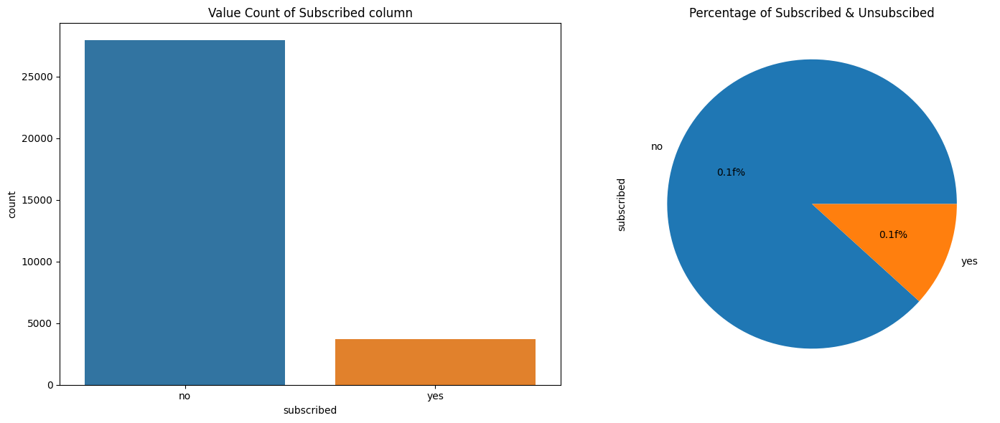

In [ ]:
# Visualizing it

fig, axes = plt.subplots(1,2,figsize=(15,6))

# First plot: Value count of the column using count plot
sns.countplot(x='subscribed', data=train, ax=axes[0])
axes[0].set_title('Value Count of Subscribed column')

# Second plot: Percentage of Subscribed & Unsubcribed
train['subscribed'].value_counts().plot(kind='pie', autopct="0.1f%%", ax=axes[1])
axes[1].set_title('Percentage of Subscribed & Unsubscibed')

plt.tight_layout()
plt.show()

### `Observation:`

- The 'subscribed' column has two unique values: 'no' and 'yes'.
- The total count of 'no' in the column is 27,932.
- The total count of 'yes' in the column is 3,715.
- The percentage of 'no' in the column is approximately 88.26%.
- The percentage of 'yes' in the column is approximately 11.74%.

This indicates that the majority of the data falls under the 'no' category in the 'subscribed' column, with 'yes' accounting for a smaller portion of the data. Thats means our data is imbalanced.

## a. Univariate Analysis

### i. Categorical columns of train dataframe

In [ ]:
# Checking Value Counts of Categorical Column(Train Data)
cat_col = cat_col[:-1]

for col in cat_col:
    print('*'*10,col,'*'*10)
    print(train[col].value_counts())
    print("\n")

********** job **********
blue-collar      6842
management       6639
technician       5307
admin.           3631
services         2903
retired          1574
self-employed    1123
entrepreneur     1008
unemployed        905
housemaid         874
student           635
unknown           206
Name: job, dtype: int64


********** marital **********
married     19095
single       8922
divorced     3630
Name: marital, dtype: int64


********** education **********
secondary    16224
tertiary      9301
primary       4808
unknown       1314
Name: education, dtype: int64


********** default **********
no     31062
yes      585
Name: default, dtype: int64


********** housing **********
yes    17584
no     14063
Name: housing, dtype: int64


********** loan **********
no     26516
yes     5131
Name: loan, dtype: int64


********** contact **********
cellular     20423
unknown       9177
telephone     2047
Name: contact, dtype: int64


********** month **********
may    9669
jul    4844
aug    43

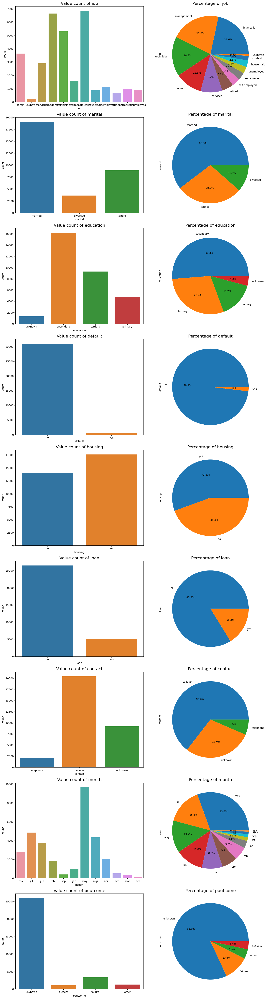

In [ ]:
#Visualizing it

# Create subplots
fig, axes = plt.subplots(len(cat_col), 2, figsize=(15, 6*len(cat_col)))

# Iterate through categorical columns
for i, column in enumerate(cat_col):
    # Count plot
    sns.countplot(x=column, data=train, ax=axes[i][0])
    axes[i][0].set_title(f"Value count of {column}", fontsize=16)

    # Pie chart for percentage
    train[column].value_counts().plot(kind="pie", autopct="%0.1f%%", ax=axes[i][1])
    axes[i][1].set_title(f"Percentage of {column}", fontsize=16)

plt.tight_layout()
plt.show()

### `Observations:`

**job**:
- The 'job' column represents the occupation or job type of individuals.
- The most common job categories are 'blue-collar,' 'management,' 'technician,' and 'admin.'
- 'Blue-collar' is the most frequent job category, with 6,842 individuals having this occupation.

**marital**:
- The 'marital' column represents the marital status of individuals.
- The most common marital status categories are 'married' and 'single.'
- 'Married' is the most frequent marital status, with 19,095 individuals.

**education**:
- The 'education' column represents the education level of individuals.
- The majority of individuals have 'secondary' education, followed by 'tertiary' and 'primary' education.
- 'Secondary' education is the most common, with 16,224 individuals having this education level.

**default**:
- The 'default' column likely indicates whether individuals have credit in default.
- The majority of individuals do not have credit in default ('no'), while a smaller proportion have credit in default ('yes').

**housing**:
- The 'housing' column may indicate whether individuals have housing loans.
- More individuals have housing loans ('yes') compared to those without ('no').

**loan**:
- The 'loan' column represents whether individuals have personal loans.
- Most individuals do not have personal loans ('no').

**contact**:
- The 'contact' column may indicate the method of communication.
- 'Cellular' is the most common contact method, followed by 'unknown' and 'telephone.'

**month**:
- The 'month' column represents the month in which contacts were made.
- The most frequently used contact month is 'May,' followed by 'July' and 'August.'

**poutcome**:
- The 'poutcome' column might represent the outcome of a previous marketing campaign.
- The most common outcome is 'unknown,' followed by 'failure,' 'other,' and 'success.'

These observations provide insights into the distribution and frequencies of categories within each categorical variable, which is valuable for understanding the characteristics of the dataset.

### ii. Numerical Column of Train Data

In [ ]:
#Creating for loop to iterate over Numerical columns

for col in num_col:
    print('*'*10,col,'*'*10)
    print(train[col].value_counts())
    print("\n")

********** ID **********
26110    1
13339    1
39681    1
15135    1
26037    1
        ..
1247     1
15584    1
25376    1
38699    1
14156    1
Name: ID, Length: 31647, dtype: int64


********** age **********
32    1457
31    1417
33    1406
34    1321
35    1314
      ... 
92       1
95       1
93       1
94       1
90       1
Name: age, Length: 76, dtype: int64


********** balance **********
 0        2470
 1         137
 2         109
 4          95
 3          88
          ... 
 15120       1
-713         1
-905         1
 4722        1
 2968        1
Name: balance, Length: 6326, dtype: int64


********** day **********
20    1909
18    1612
21    1445
5     1373
6     1348
17    1344
14    1283
8     1281
28    1276
29    1241
7     1240
19    1228
15    1208
12    1116
13    1099
9     1097
30    1082
4     1016
11    1014
16     981
2      900
27     804
3      761
26     761
23     657
22     640
25     586
31     460
10     360
24     305
1      220
Name: day, dtype: int64

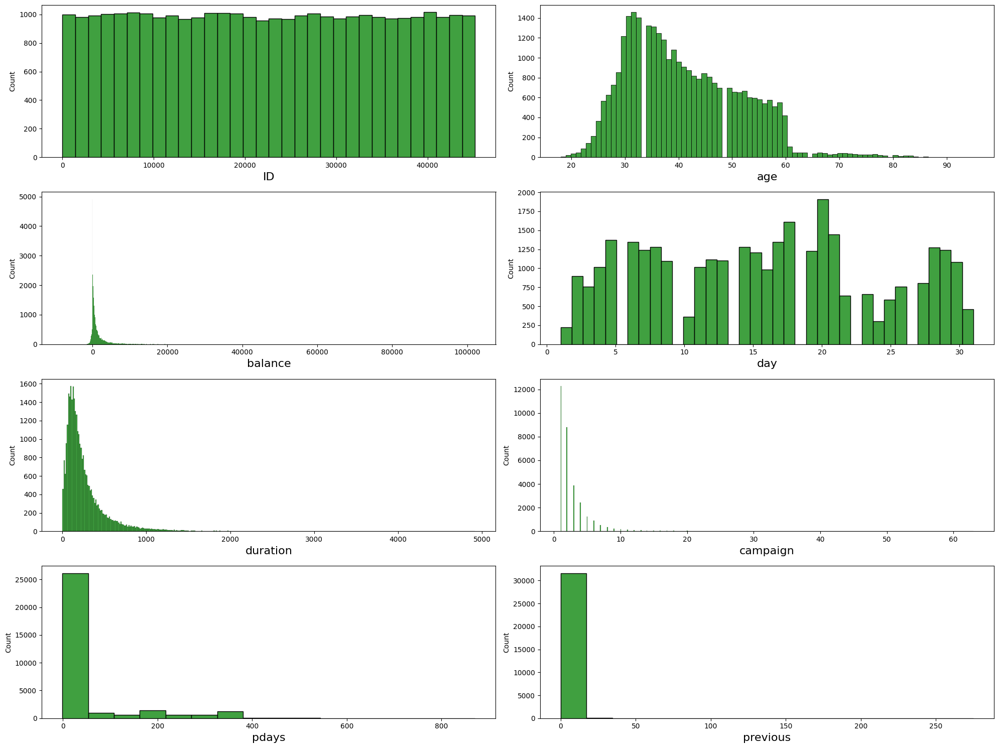

In [ ]:
# Visualizing numerical columns
plt.figure(figsize=(20, 15), facecolor='white')
plotnumber = 1

for column in num_col:
    if plotnumber <= 8:
        ax = plt.subplot(4,2, plotnumber)
        sns.histplot(train[column], color='g')
        plt.xlabel(column, fontsize=16)
    plotnumber += 1

plt.tight_layout()
plt.show()

### `Observations:`

**ID:**
- The ID column appears to be unique, with each value occurring only once. This suggests that it might be an identifier for each row.

**Age:**
- The age column shows a distribution of ages, with the most common ages being around 32, 31, and 33.
- Age varies from 18 to 95.

**Balance:**
- The balance column has a wide range of values, including both positive and negative balances.
- The most common balance value is 0, followed by 1 and 2.

**Day:**
- The day column represents the day of the month. It shows a distribution of days, with some days being more common than others.
- The most common days are around the 20th, 18th, and 21st of the month.

**Duration:**
- The duration column represents the duration of the contact in seconds. It varies widely, with many different values.
- There are multiple occurrences of similar durations, indicating that certain call durations are more common.

**Campaign:**
- The campaign column represents the number of contacts performed during the campaign. It shows a distribution with most values between 1 and 10 contacts.
- There are a few outliers with higher numbers of contacts.

**Pdays:**
- The pdays column represents the number of days since the client was last contacted. The majority of values are -1, indicating that most clients were not previously contacted.
- There are a few positive values indicating the number of days since the last contact for some clients.

**Previous:**
- The previous column represents the number of contacts performed before this campaign. It shows a distribution with most values being 0.
- There are some non-zero values, indicating that some clients were contacted in previous campaigns.

These observations provide insights into the distribution and characteristics of the numerical columns in the dataset.

## b. Bivariate Analysis

#### i. Categorical Columns Vs Target

In [ ]:
# Create a contingency table for 'job' and 'subscribed'
job_crosstab = pd.crosstab(train['job'], train['subscribed'])

# Calculate the percentage
job_crosstab_norm = job_crosstab.div(job_crosstab.sum(1).astype(float), axis=0)

# Concatenate the contingency table and normalized contingency table side by side
concatenated_tables = pd.concat([job_crosstab, job_crosstab_norm], axis=1, keys=['Count', 'Percentage'])
concatenated_tables

Count      Percentage          
subscribed       no  yes         no       yes
job                                          
admin.         3179  452   0.875516  0.124484
blue-collar    6353  489   0.928530  0.071470
entrepreneur    923   85   0.915675  0.084325
housemaid       795   79   0.909611  0.090389
management     5716  923   0.860973  0.139027
retired        1212  362   0.770013  0.229987
self-employed   983  140   0.875334  0.124666
services       2649  254   0.912504  0.087496
student         453  182   0.713386  0.286614
technician     4713  594   0.888072  0.111928
unemployed      776  129   0.857459  0.142541
unknown         180   26   0.873786  0.126214

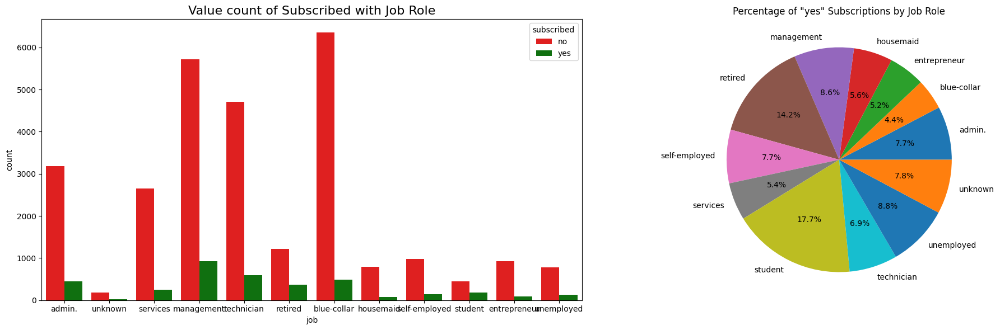

In [ ]:
# Visualizing it
fig, axes = plt.subplots(1, 2, figsize=(20, 6))  # Use plt.subplots to create subplots

# First Plot: Value count of Subscribed with Marital status
sns.countplot(x='job', hue='subscribed', data=train, palette={"yes": "g", "no": "r"}, ax=axes[0])
axes[0].set_title('Value count of Subscribed with Job Role', fontsize=16)

# Second Plot: Percentage of Yes subscribed by Job role
yes_percentages = job_crosstab_norm['yes']
# Get the Job labels
job_labels = yes_percentages.index

# Create a pie chart
axes[1].pie(yes_percentages, labels=job_labels, autopct='%1.1f%%')
axes[1].set_title('Percentage of "yes" Subscriptions by Job Role')

# Show the pie chart
plt.tight_layout()
plt.show()

### `Observations:`

1. **Job vs. Subscription Count:**
   - Among the different job categories, "retired" and "student" have the highest counts of "yes" subscriptions, with 362 and 182 respectively.
   - "Entrepreneur" and "unknown" have the lowest counts of "yes" subscriptions, with 85 and 26 respectively.
   - "Admin" and "blue-collar" jobs have relatively high counts of both "yes" and "no" subscriptions, with 452 and 489 "yes" subscriptions, and 3179 and 6353 "no" subscriptions respectively.

2. **Job vs. Subscription Percentage:**
   - When looking at the percentage of "yes" subscriptions within each job category, "student" stands out with the highest percentage at approximately 28.66%.
   - "Retired" individuals also have a significant percentage of "yes" subscriptions at around 23.00%.
   - "Blue-collar" workers have the lowest percentage of "yes" subscriptions, accounting for only about 7.15% of the total in their category.
   - "Management" professionals have a relatively high percentage of "yes" subscriptions, with approximately 13.90%.

3. **Overall:**
   - The percentage of "yes" subscriptions varies significantly across different job categories, indicating that job type may be a significant factor in predicting whether an individual subscribes to the service or not.
   - "Student" and "retired" individuals are more likely to subscribe, while "blue-collar" workers are less likely to subscribe.

These observations provide insights into how the "job" variable relates to the subscription outcome, which can be valuable for targeted marketing strategies or further analysis in the context of this dataset.

In [ ]:
#Marital status vs subscribed
marital_crosstab= pd.crosstab(train['marital'], train['subscribed'])

#Calculating the percentage
marital_crosstab_norm = marital_crosstab.div(marital_crosstab.sum(1).astype(float), axis=0)

#concatenate marital crosstab and marital crosstab norm side by side
marital_concat=pd.concat([marital_crosstab, marital_crosstab_norm], axis=1, keys=["count", "Percentage"])
marital_concat

count       Percentage          
subscribed     no   yes         no       yes
marital                                     
divorced     3185   445   0.877410  0.122590
married     17176  1919   0.899502  0.100498
single       7571  1351   0.848577  0.151423

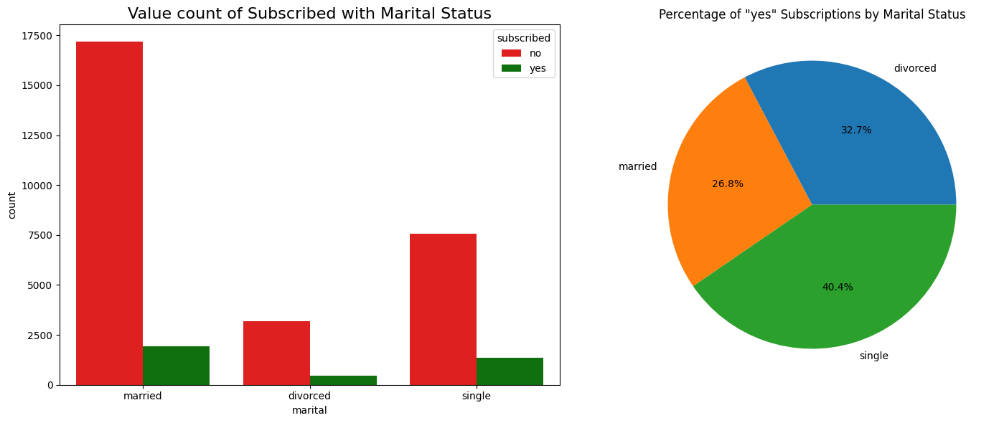

In [ ]:
# Visualizing it
fig, axes = plt.subplots(1, 2, figsize=(15, 6))  # Use plt.subplots to create subplots

# First Plot: Value count of Subscribed with Marital status
sns.countplot(x='marital', hue='subscribed', data=train, palette={"yes": "g", "no": "r"}, ax=axes[0])
axes[0].set_title('Value count of Subscribed with Marital Status', fontsize=16)

# Second Plot: Percentage of Yes subscribed by Marital status
yes_percentages = marital_crosstab_norm['yes']
# Get the marital status labels
marital_labels = yes_percentages.index

# Create a pie chart
axes[1].pie(yes_percentages, labels=marital_labels, autopct='%1.1f%%')
axes[1].set_title('Percentage of "yes" Subscriptions by Marital Status')

# Show the pie chart
plt.tight_layout()
plt.show()

### `Observations:`

1. **Marital Status vs. Subscription Count:**
   - Among the different marital statuses, individuals who are "married" have the highest count of "no" subscriptions, with 17,176 individuals.
   - On the other hand, individuals who are "single" have the highest count of "yes" subscriptions, with 1,351 individuals.
   - "Divorced" individuals fall in between, with 3,185 "no" subscriptions and 445 "yes" subscriptions.

2. **Marital Status vs. Subscription Percentage:**
   - When looking at the percentage of "yes" subscriptions within each marital status category:
     - "Single" individuals have the highest percentage of "yes" subscriptions at approximately 15.14%.
     - "Divorced" individuals have the lowest percentage of "yes" subscriptions, accounting for about 12.26% of their category.
     - "Married" individuals have a moderate percentage of "yes" subscriptions, approximately 10.05%.

3. **Overall:**
   - The marital status appears to have an influence on the subscription outcome.
   - "Single" individuals have a notably higher likelihood of subscribing compared to "married" and "divorced" individuals.
   - These observations suggest that marital status may be a relevant factor in predicting whether an individual subscribes to the service or not.

These insights into the relationship between marital status and subscription status can be valuable for marketing strategies and further analysis in the context of this dataset.

In [ ]:
# Create a contingency table for 'job' and 'subscribed'
job_crosstab = pd.crosstab(train['job'], train['subscribed'])

# Calculate the percentage
job_crosstab_norm = job_crosstab.div(job_crosstab.sum(1).astype(float), axis=0)

# Concatenate the contingency table and normalized contingency table side by side
concatenated_tables = pd.concat([job_crosstab, job_crosstab_norm], axis=1, keys=['Count', 'Percentage'])

# Print the concatenated tables
print(concatenated_tables)

              Count      Percentage          
subscribed       no  yes         no       yes
job                                          
admin.         3179  452   0.875516  0.124484
blue-collar    6353  489   0.928530  0.071470
entrepreneur    923   85   0.915675  0.084325
housemaid       795   79   0.909611  0.090389
management     5716  923   0.860973  0.139027
retired        1212  362   0.770013  0.229987
self-employed   983  140   0.875334  0.124666
services       2649  254   0.912504  0.087496
student         453  182   0.713386  0.286614
technician     4713  594   0.888072  0.111928
unemployed      776  129   0.857459  0.142541
unknown         180   26   0.873786  0.126214


In [ ]:
# Education Vs subscribed

edu_crosstab =pd.crosstab(train['education'],train['subscribed'])

# Calculate the percentage
edu_crosstab_norm = edu_crosstab.div(edu_crosstab.sum(1).astype(float),axis=0)

# Concatenated the contingency table and normalize contingency table side by side
edu_concat = pd.concat([edu_crosstab, edu_crosstab_norm], axis=1, keys=['Count','Percentage'])
edu_concat

Count       Percentage          
subscribed     no   yes         no       yes
education                                   
primary      4381   427   0.911190  0.088810
secondary   14527  1697   0.895402  0.104598
tertiary     7886  1415   0.847866  0.152134
unknown      1138   176   0.866058  0.133942

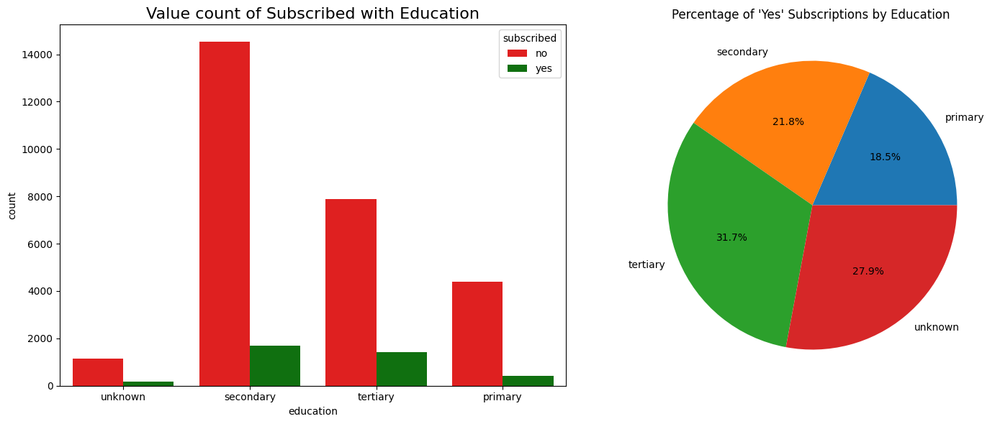

In [ ]:
# Visualization

fig, axes= plt.subplots(1,2, figsize=(15,6)) #Creating for subplots

#First Plot: Value count of Subscribed with Education
sns.countplot(x='education', hue='subscribed', data=train, palette={"yes":"g","no":"r"}, ax=axes[0])
axes[0].set_title('Value count of Subscribed with Education', fontsize=16)

# Second Plot: Percentage of "Yes" subscribed with Education
yes_percentage= edu_crosstab_norm['yes']

#Get Education labels
education_labels=yes_percentage.index

# Create a Pie chart
axes[1].pie(yes_percentage, labels=education_labels, autopct='%1.1f%%')
axes[1].set_title("Percentage of 'Yes' Subscriptions by Education ")

plt.tight_layout()
plt.show()

### `Observations:`

* **Primary Education:**
        - Count of "No" Subscriptions: 4,381
        - Count of "Yes" Subscriptions: 427
        - Percentage of "No" Subscriptions: 91.12%
        - Percentage of "Yes" Subscriptions: 8.88%
    
* **Secondary Education:**
        - Count of "No" Subscriptions: 14,527
        - Count of "Yes" Subscriptions: 1,697
        - Percentage of "No" Subscriptions: 89.54%
        - Percentage of "Yes" Subscriptions: 10.46%
    
* **Tertiary Education:**
        - Count of "No" Subscriptions: 7,886
        - Count of "Yes" Subscriptions: 1,415
        - Percentage of "No" Subscriptions: 84.79%
        - Percentage of "Yes" Subscriptions: 15.21%
    
* **Unknown Education:**
        - Count of "No" Subscriptions: 1,138
        - Count of "Yes" Subscriptions: 176
        - Percentage of "No" Subscriptions: 86.61%
        - Percentage of "Yes" Subscriptions: 13.39%

These observations provide insights into the distribution of subscriptions based on education levels. It appears that the percentage of "Yes" subscriptions is higher among individuals with tertiary education compared to other education categories, while the primary education category has the highest percentage of "No" subscriptions.

In [ ]:
# Default vs Subscribed

default_crosstab=pd.crosstab(train['default'],train['subscribed'])

#Percentage Calculate
default_crosstab_norm = default_crosstab.div(default_crosstab.sum(1).astype(float),axis=0)

#concate both tables
default_concat=pd.concat([default_crosstab, default_crosstab_norm], axis=1, keys=['Count', 'Percentage'])
default_concat

Count       Percentage          
subscribed     no   yes         no       yes
default                                     
no          27388  3674   0.881720  0.118280
yes           544    41   0.929915  0.070085

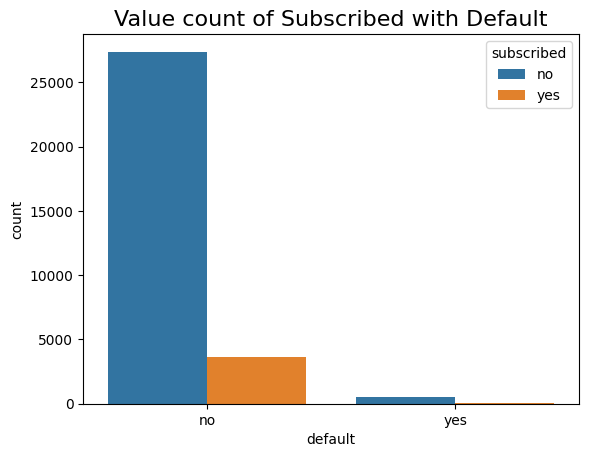

In [ ]:
# Visualizing it: Value count of Default vs Subscribed
sns.countplot(x='default', hue='subscribed', data=train)
plt.title('Value count of Subscribed with Default', fontsize=16)
plt.show()

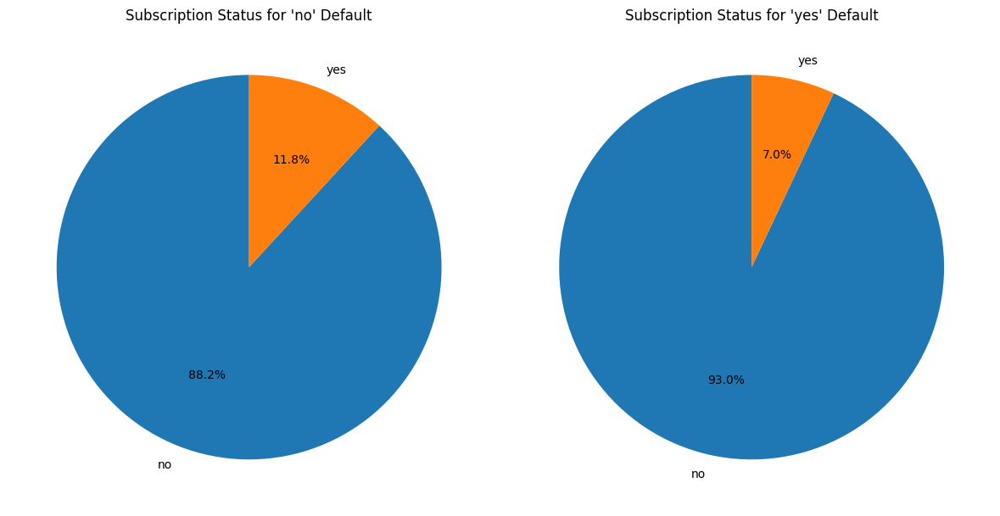

In [ ]:
# Pie Plot: For percentage of subscribed vs Defaulter & Non Default
default_categories = train['default'].unique()

# Create subplots for each default category
fig, axes = plt.subplots(1, len(default_categories), figsize=(12, 6))

for i, default_category in enumerate(default_categories):
    default_subscribed_counts = train[train['default'] == default_category]['subscribed'].value_counts()

    # Plot pie chart for the current default category
    axes[i].pie(default_subscribed_counts, labels=default_subscribed_counts.index, autopct='%1.1f%%', startangle=90)
    axes[i].set_title(f"Subscription Status for '{default_category}' Default")

plt.tight_layout()
plt.show()


### `Observation`:

- For customers with no previous default (default=no):
  - Count: 27,388 customers did not subscribe ('no'), and 3,674 customers subscribed ('yes').
  - Percentage: Approximately 88.17% of customers with no previous default did not subscribe, while around 11.83% of them subscribed.

- For customers with a previous default (default=yes):
  - Count: 544 customers did not subscribe ('no'), and 41 customers subscribed ('yes').
  - Percentage: Approximately 92.99% of customers with a previous default did not subscribe, while around 7.01% of them subscribed.

This suggests that customers with no previous default are more likely to subscribe compared to those with a previous default, as indicated by the higher subscription rate (11.83% vs. 7.01%) among the former group.

In [ ]:
# Housing vs Subscribed

Housing = pd.crosstab(train['housing'], train['subscribed']) #Value Count
Percentage = Housing.div(Housing.sum(1).astype(float), axis= 0) # Percentage

housing_concat=pd.concat([Housing,Percentage], axis=1, keys=['Count','Percentage'])
housing_concat

Count       Percentage          
subscribed     no   yes         no       yes
housing                                     
no          11698  2365   0.831828  0.168172
yes         16234  1350   0.923226  0.076774

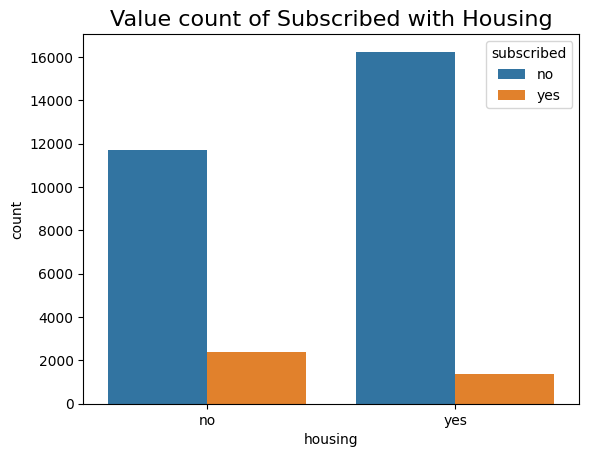

In [ ]:
#visualizing it

# First plot: Value count of housing vs Subscribed
sns.countplot(x='housing', hue='subscribed', data=train)
plt.title('Value count of Subscribed with Housing', fontsize=16)
plt.show()

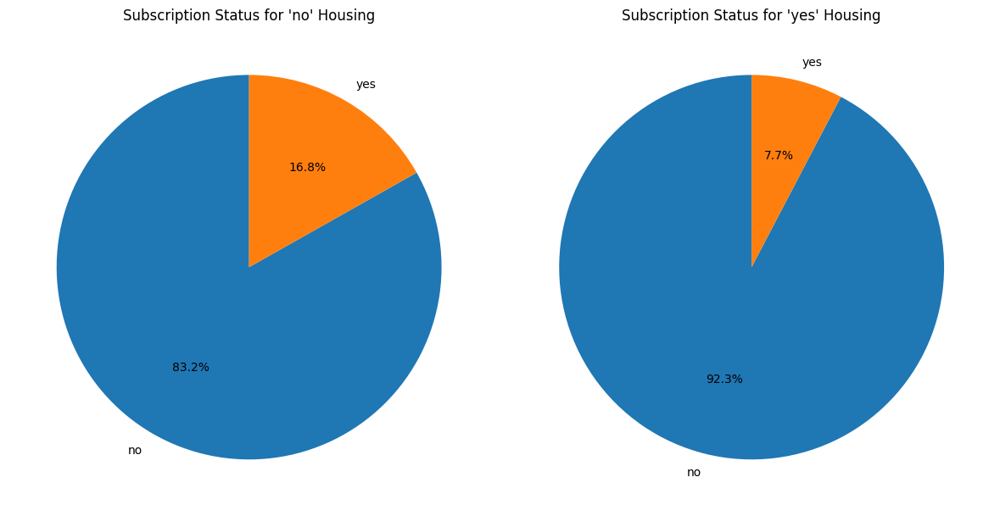

In [ ]:
# Pie Plot: For percentage of subscribed vs Housing
housing_categories = train['housing'].unique()

# Create subplots for each housing category
fig, axes = plt.subplots(1, len(housing_categories), figsize=(12, 6))

for i, housing_category in enumerate(housing_categories):
    housing_subscribed_counts = train[train['housing'] == housing_category]['subscribed'].value_counts()

    # Plot pie chart for the current housing category
    axes[i].pie(housing_subscribed_counts, labels=housing_subscribed_counts.index, autopct='%1.1f%%', startangle=90)
    axes[i].set_title(f"Subscription Status for '{housing_category}' Housing")

plt.tight_layout()
plt.show()

### `Observation:`

- **Count of Subscribed Customers:**
  - For customers with "housing" status as "no," there are 11,698 subscribers who have not subscribed (no), and 2,365 subscribers who have subscribed (yes).
  - For customers with "housing" status as "yes," there are 16,234 subscribers who have not subscribed (no), and 1,350 subscribers who have subscribed (yes).

- **Percentage of Subscribed Customers:**
  - Among customers with "housing" status as "no," approximately 83.18% have not subscribed (no), while about 16.82% have subscribed (yes).
  - Among customers with "housing" status as "yes," approximately 92.32% have not subscribed (no), while about 7.68% have subscribed (yes).

These observations provide insights into the relationship between housing status and subscription to a term deposit. It appears that customers with no housing tend to have a higher subscription rate compared to those with housing.

In [ ]:
# loan vs subscribed

loan_crosstab = pd.crosstab(train['loan'], train['subscribed']) #Value Count
Percentage = loan_crosstab.div(loan_crosstab.sum(1).astype(float), axis= 0) # Percentage

loan_concat=pd.concat([loan_crosstab,Percentage], axis=1, keys=['Count','Percentage'])
loan_concat

Count       Percentage          
subscribed     no   yes         no       yes
loan                                        
no          23132  3384   0.872379  0.127621
yes          4800   331   0.935490  0.064510

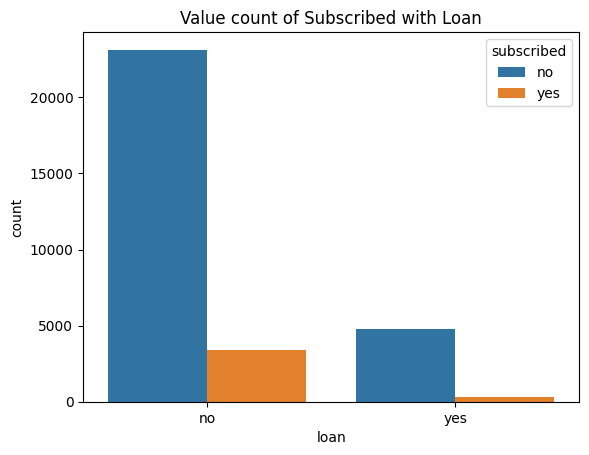

In [ ]:
#visualizing it

# First plot: Value count of Loan vs Subscribed
sns.countplot(x='loan', hue='subscribed', data=train)
plt.title('Value count of Subscribed with Loan', fontsize=12)
plt.show()

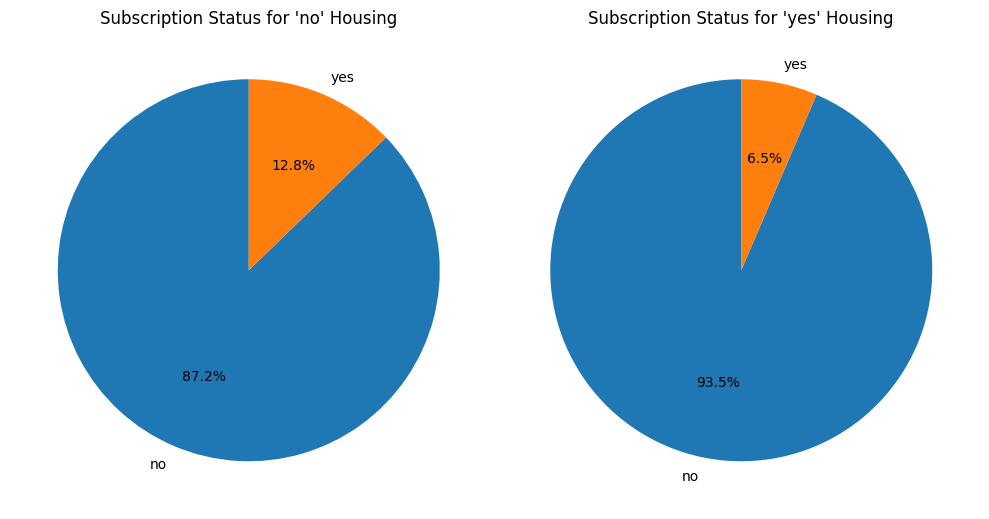

In [ ]:
# Pie Plot: For percentage of subscribed vs loan
loan_categories = train['loan'].unique()

# Create subplots for each loan category
fig, axes = plt.subplots(1, len(loan_categories), figsize=(10, 6))

for i, loan_category in enumerate(loan_categories):
    loan_subscribed_counts = train[train['loan'] == loan_category]['subscribed'].value_counts()

    # Plot pie chart for the current housing category
    axes[i].pie(loan_subscribed_counts, labels=loan_subscribed_counts.index, autopct='%1.1f%%', startangle=90)
    axes[i].set_title(f"Subscription Status for '{loan_category}' Housing")

plt.tight_layout()
plt.show()

### `Observation:`
It is evident that the count and percentage of subscribers and non-subscribers categorized by whether or not they have a loan. The "no" category represents clients without a loan, while the "yes" category represents clients with a loan. It is evident that a higher percentage of clients without a loan subscribed to the term deposit compared to those with a loan.

In [ ]:
#contact vs subscribed
contact_crosstab = pd.crosstab(train['contact'], train['subscribed']) #Value Count
Percentage = contact_crosstab.div(contact_crosstab.sum(1).astype(float), axis= 0) # Percentage

contact_concat=pd.concat([contact_crosstab,Percentage], axis=1, keys=['Count','Percentage'])
contact_concat

Count       Percentage          
subscribed     no   yes         no       yes
contact                                     
cellular    17352  3071   0.849630  0.150370
telephone    1779   268   0.869077  0.130923
unknown      8801   376   0.959028  0.040972

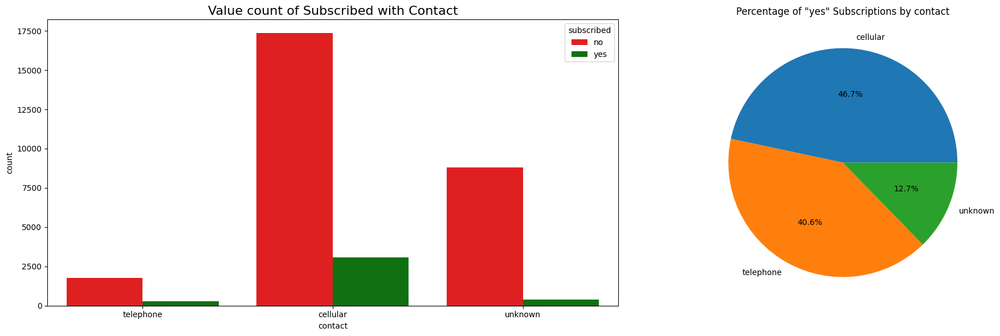

In [ ]:
# Visualizing it
fig, axes = plt.subplots(1, 2, figsize=(20, 6))  # Use plt.subplots to create subplots

# First Plot: Value count of Subscribed with Contact
sns.countplot(x='contact', hue='subscribed', data=train, palette={"yes": "g", "no": "r"}, ax=axes[0])
axes[0].set_title('Value count of Subscribed with Contact', fontsize=16)

# Second Plot: Percentage of Yes subscribed by contact
yes_percentages = Percentage['yes']
# Get the contact labels
contact_labels = yes_percentages.index

# Create a pie chart
axes[1].pie(yes_percentages, labels=contact_labels, autopct='%1.1f%%')
axes[1].set_title('Percentage of "yes" Subscriptions by contact')

# Show the pie chart
plt.tight_layout()
plt.show()

### `Observations:`

The count and percentage of subscribers and non-subscribers based on the contact method used. The "cellular" category represents clients contacted via cellular phones, "telephone" represents clients contacted via landline telephones, and "unknown" represents clients with unknown contact methods. It is evident that a higher percentage of subscribers were reached through cellular phones compared to other contact methods.

In [ ]:
#month vs subscribed

month_crosstab = pd.crosstab(train['month'], train['subscribed']) #Value Count
Percentage = month_crosstab.div(month_crosstab.sum(1).astype(float), axis= 0) # Percentage

month_concat=pd.concat([month_crosstab,Percentage], axis=1, keys=['Count','Percentage'])
month_concat

Count      Percentage          
subscribed    no  yes         no       yes
month                                     
apr         1671  384   0.813139  0.186861
aug         3813  520   0.879991  0.120009
dec           85   72   0.541401  0.458599
feb         1522  305   0.833060  0.166940
jan          880   97   0.900716  0.099284
jul         4403  441   0.908960  0.091040
jun         3355  383   0.897539  0.102461
mar          168  174   0.491228  0.508772
may         9020  649   0.932878  0.067122
nov         2508  275   0.901186  0.098814
oct          288  224   0.562500  0.437500
sep          219  191   0.534146  0.465854

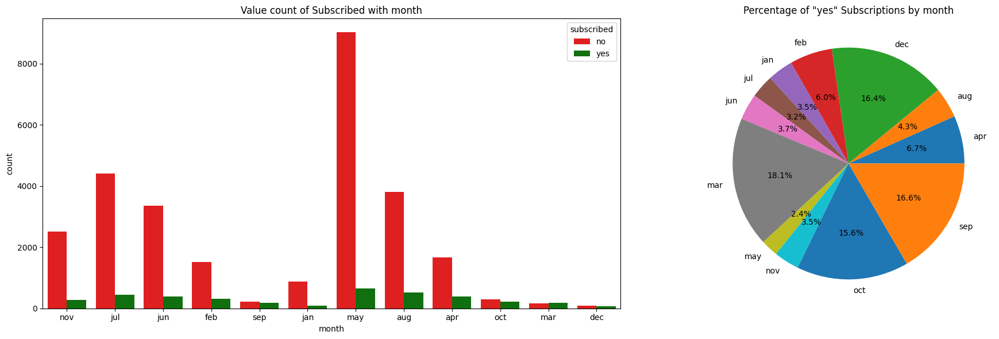

In [ ]:
# Visualizing it
fig, axes = plt.subplots(1, 2, figsize=(20, 6))  # Use plt.subplots to create subplots

# First Plot: Value count of Subscribed with month
sns.countplot(x='month', hue='subscribed', data=train, palette={"yes": "g", "no": "r"}, ax=axes[0])
axes[0].set_title('Value count of Subscribed with month', fontsize=12)

# Second Plot: Percentage of Yes subscribed by month
month_counts = pd.crosstab(train['month'], train['subscribed'])
month_percentage = month_counts.div(month_counts.sum(1).astype(float), axis=0)

# Get the percentage of "yes" subscriptions
yes_percentages = month_percentage['yes']

# Create a pie chart
axes[1].pie(yes_percentages, labels=yes_percentages.index, autopct='%1.1f%%')
axes[1].set_title('Percentage of "yes" Subscriptions by month')

# Show the pie chart
plt.tight_layout()
plt.show()

### `Observations:`

- In the month of April (apr), there were 1,671 subscriptions, with 384 (18.7%) being "yes."

- August (aug) had 3,813 subscriptions, with 520 (12%) of them being "yes."

- December (dec) had the smallest number of subscriptions, with 85 in total. However, a high percentage of them, 72 (45.9%), were "yes."

- February (feb) had 1,522 subscriptions, and 305 (16.7%) of them were "yes."

- January (jan) had 880 subscriptions, with 97 (9.9%) being "yes."

- July (jul) had 4,403 subscriptions, and 441 (9.1%) were "yes."

- June (jun) had 3,355 subscriptions, and 383 (10.2%) were "yes."

- March (mar) had 168 subscriptions, with 174 (50.9%) of them being "yes."

- May (may) had the highest number of subscriptions, with 9,020 in total. However, only 649 (6.7%) of them were "yes."

- November (nov) had 2,508 subscriptions, with 275 (9.9%) being "yes."

- October (oct) had 288 subscriptions, with 224 (43.8%) being "yes."

- September (sep) had 219 subscriptions, with 191 (46.6%) being "yes."

These observations provide insights into the distribution of subscriptions across different months, highlighting variations in both count and percentage of "yes" subscriptions.

In [ ]:
#poutcome vs subscribed

poutcome_crosstab = pd.crosstab(train['poutcome'], train['subscribed']) #Value Count
Percentage = poutcome_crosstab.div(poutcome_crosstab.sum(1).astype(float), axis= 0) # Percentage

poutcome_concat=pd.concat([poutcome_crosstab,Percentage], axis=1, keys=['Count','Percentage'])
poutcome_concat

Count       Percentage          
subscribed     no   yes         no       yes
poutcome                                    
failure      2931   431   0.871802  0.128198
other        1071   217   0.831522  0.168478
success       374   694   0.350187  0.649813
unknown     23556  2373   0.908481  0.091519

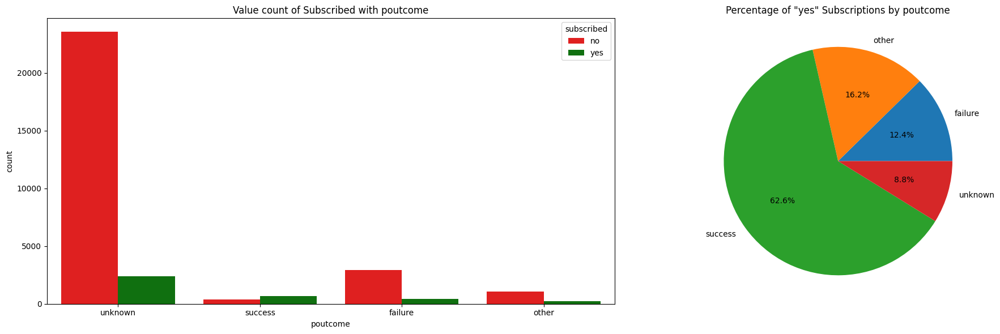

In [ ]:
# Visualizing it
fig, axes = plt.subplots(1, 2, figsize=(20, 6))  # Use plt.subplots to create subplots

# First Plot: Value count of Subscribed with poutcome
sns.countplot(x='poutcome', hue='subscribed', data=train, palette={"yes": "g", "no": "r"}, ax=axes[0])
axes[0].set_title('Value count of Subscribed with poutcome', fontsize=12)

# Second Plot: Percentage of Yes subscribed by poutcome
poutcome_counts = pd.crosstab(train['poutcome'], train['subscribed'])
poutcome_percentage = poutcome_counts.div(poutcome_counts.sum(1).astype(float), axis=0)

# Get the percentage of "yes" subscriptions
yes_percentages = poutcome_percentage['yes']

# Create a pie chart
axes[1].pie(yes_percentages, labels=yes_percentages.index, autopct='%1.1f%%')
axes[1].set_title('Percentage of "yes" Subscriptions by poutcome')

# Show the pie chart
plt.tight_layout()
plt.show()

### ii. Bivariate Analysis for Numeric columns with Target

In [ ]:
#campaign vs Subscribed
train.groupby(['campaign'])['subscribed'].count().reset_index().sort_values(by='subscribed', ascending=False)

,campaign,subscribed
0,1,12262
1,2,8798
2,3,3858
3,4,2442
4,5,1245
5,6,916
6,7,518
7,8,356
8,9,236
9,10,184


### `Observation:`
* The majority of clients were contacted fewer times during the campaign, with the most common counts being 1, 2, and 3.

* As the number of campaign contacts increased beyond 3, the counts of clients contacted decreased significantly. This suggests that a large portion of clients were contacted relatively few times.

* The subscription rate tends to decrease as the number of campaign contacts increases. Clients who were contacted only once or twice had a higher subscription rate compared to those contacted more frequently.

* There is a noticeable drop in the subscription rate after the 6th campaign contact, with a steep decline in subscriptions as the number of contacts continues to increase.

* It's interesting to note that there are instances where clients were contacted up to 63 times during the campaign, but the subscription rate remains low for these cases.

In [ ]:
# Age vs Subscribed
pd.set_option('display.max_rows', None)
train.groupby(['age'])['subscribed'].count().reset_index().sort_values(by='subscribed', ascending=False)

,age,subscribed
14,32,1457
13,31,1417
15,33,1406
16,34,1321
17,35,1314
18,36,1245
12,30,1219
19,37,1181
21,39,1079
20,38,985


### `Observations:`
* The age of 32 has the highest number of subscribers, with 1457 individuals.
* Ages 31, 33, 34, and 35 also have a substantial number of subscribers, ranging from 1314 to 1417.
* The number of subscribers generally decreases as age increases, with fewer subscribers in the older age groups.
* There are very few subscribers in the age groups beyond 60, with ages 61 and above having the lowest numbers of subscribers.
* Ages between 18 and 28 have a moderate number of subscribers.

Overall, the data suggests that the majority of subscribers are in their early thirties, and the number of subscribers tends to decrease as age increases beyond that point.

In [ ]:
#Balance vs Subscribed
train.groupby(['balance'])['subscribed'].count().reset_index().sort_values(by='subscribed', ascending=False)

,balance,subscribed
819,0,2470
820,1,137
821,2,109
823,4,95
822,3,88
824,5,78
825,6,62
827,8,52
842,23,48
829,10,48


### `Observations:`

It's evident that the balance variable doesn't have a significant impact on detecting whether someone has subscribed to the terms or not.

In [ ]:
# Day vs Subscribed
train.groupby(['day'])['subscribed'].count().reset_index().sort_values(by='subscribed', ascending=False)

,day,subscribed
19,20,1909
17,18,1612
20,21,1445
4,5,1373
5,6,1348
16,17,1344
13,14,1283
7,8,1281
27,28,1276
28,29,1241


### `Observations:`

1. The dataset contains two columns: "day" and "subscribed."

2. The "day" values range from 0 to 30, indicating a time period of one month.

3. The "subscribed" values vary, with the highest being 1909 and the lowest being 220.

4. There appears to be a general downward trend in the "subscribed" values as the "day" values increase, suggesting a potential decrease in subscriptions over time.

5. There are a few instances where the "subscribed" values remain relatively stable despite changes in the "day" values, such as around days 16-17, 20-21, and 27-28.

6. Day 19 has the highest number of subscriptions with 1909, indicating a potential peak in subscriptions during that day.

7. Days 0 and 30 have the lowest number of subscriptions with 220 and 460, respectively, suggesting lower activity or interest in subscriptions at the beginning and end of the month.

These observations provide an initial overview of the data and may serve as a basis for further analysis or exploration.

In [ ]:
# Pdays vs subscribed
train.groupby(['pdays'])['subscribed'].count().reset_index().sort_values(by='subscribed', ascending=False)

,pdays,subscribed
0,-1,25924
177,182,118
87,92,100
86,91,87
178,183,85
176,181,75
365,370,65
179,184,62
90,95,54
180,185,51


### `Observations:`

The timing of client contacts, as represented by "pdays," can have an impact on subscription rates, with shorter time intervals since the last contact generally associated with higher subscription counts. However, this relationship is not strictly linear, and other factors may also play a role in determining subscription outcomes. Further analysis may be needed to explore these relationships in more detail.

In [ ]:
# duration vs subscribed
train.groupby(['duration'])['subscribed'].count().reset_index().sort_values(by='subscribed', ascending=False)

,duration,subscribed
89,90,135
123,124,130
87,88,127
138,139,127
103,104,127
75,76,125
111,112,125
134,135,124
88,89,123
135,136,123


### `Observations:`
It suggest that contact duration isnot that imapact on detecting subscribe

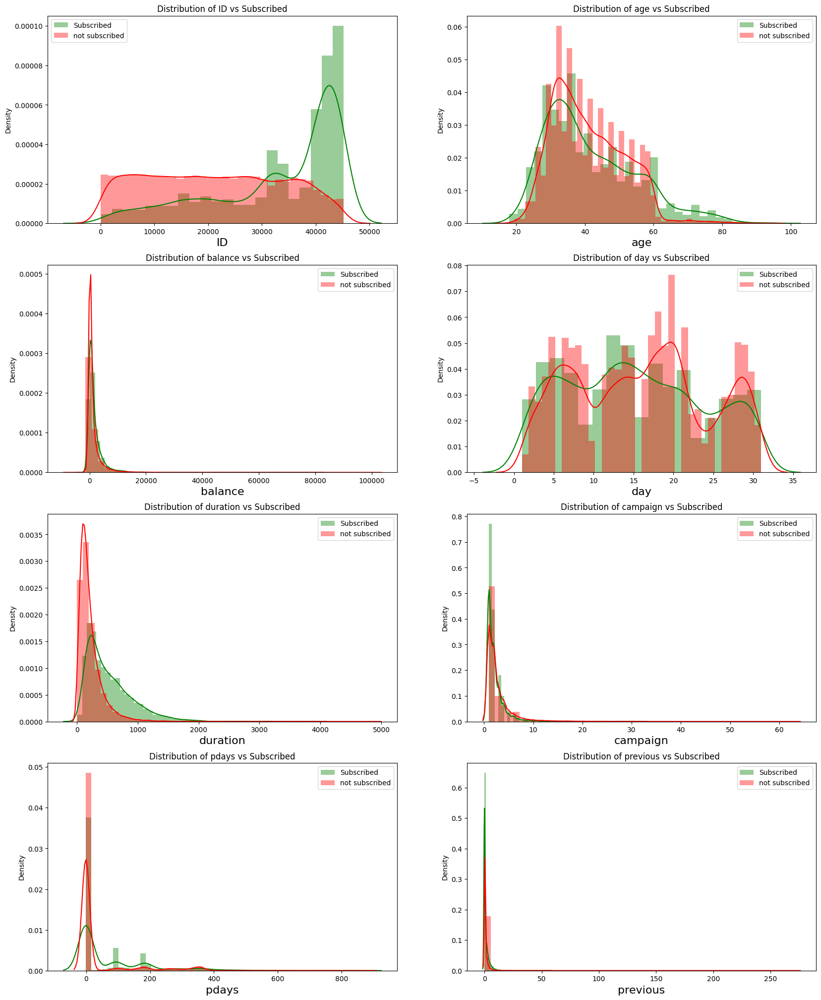

In [ ]:
#Visulazing it
plt.figure(figsize=(20,25))
p=1
for i in num_col:
    if p<=8:
        plt.subplot(4,2,p)
        sns.distplot(train[train['subscribed'] == "yes"][i], label='Subscribed', color='g')
        sns.distplot(train[train['subscribed'] == "no"][i], label='not subscribed', color='r')
        plt.title(f'Distribution of {i} vs Subscribed')
        plt.xlabel(i, fontsize=16)
        plt.legend()
    p+=1
plt.show()

## Outlier Analysis & Treatment

### a. TRAIN Data Outlier detection

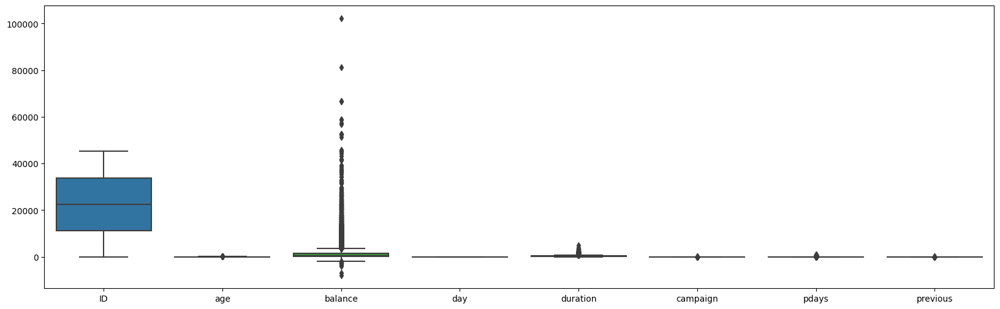

In [ ]:
plt.figure(figsize=(20,6))
sns.boxplot(train)
plt.show()

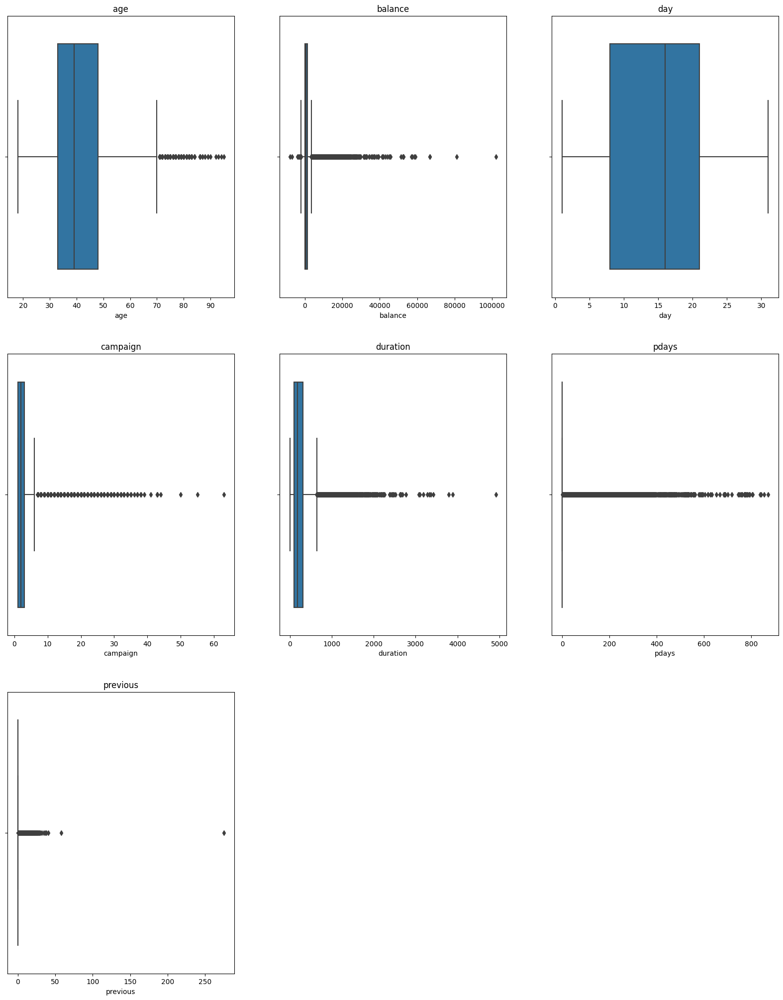

In [ ]:
col = train[['age', 'balance', 'day', 'campaign', 'duration', 'pdays', 'previous']]

plt.figure(figsize=(20, 25))

# Initialize subplot counter
plotnumber = 1

# Loop through the columns
for i in col:
    if plotnumber <= 7:  # You can set the number of subplots you want here
        plt.subplot(3, 3, plotnumber)  # 3 rows, 4 columns of subplots
        sns.boxplot(x=train[i])  # Use x parameter to create vertical box plots
        plt.title(i)
        plotnumber += 1  # Increment the subplot counter

plt.show()

### Handling Outliers using Zscore

In [ ]:
z = np.abs(zscore(train[['age','balance','duration','campaign','pdays','previous']]))

#dropping outliers
train_new=train[(z<3).all(axis=1)]

#Data loss percentage after using Zscore
print("Old DataFrame: ",train.shape[0])
print("New DataFrame: ",train_new.shape[0])
data_loss_percentage= ((train.shape[0]-train_new.shape[0])/train.shape[0])*100
print("Data loss Percentage: {:.2f}".format(data_loss_percentage))

Old DataFrame:  31647
New DataFrame:  28124
Data loss Percentage: 11.13


In [ ]:
#Checking with IQR method
Q1=train.quantile(0.25)
Q3=train.quantile(0.75)

IQR = Q3-Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
train2=train[~((train<(Q1-1.5 *IQR))|(train>(Q3+1.5*IQR))).any(axis=1)]
print("Data Loss Percentage After removing Outliers with IQR method: ",((train.shape[0]-train2.shape[0])/train.shape[0])*100)

Data Loss Percentage After removing Outliers with IQR method:  37.437987802951305


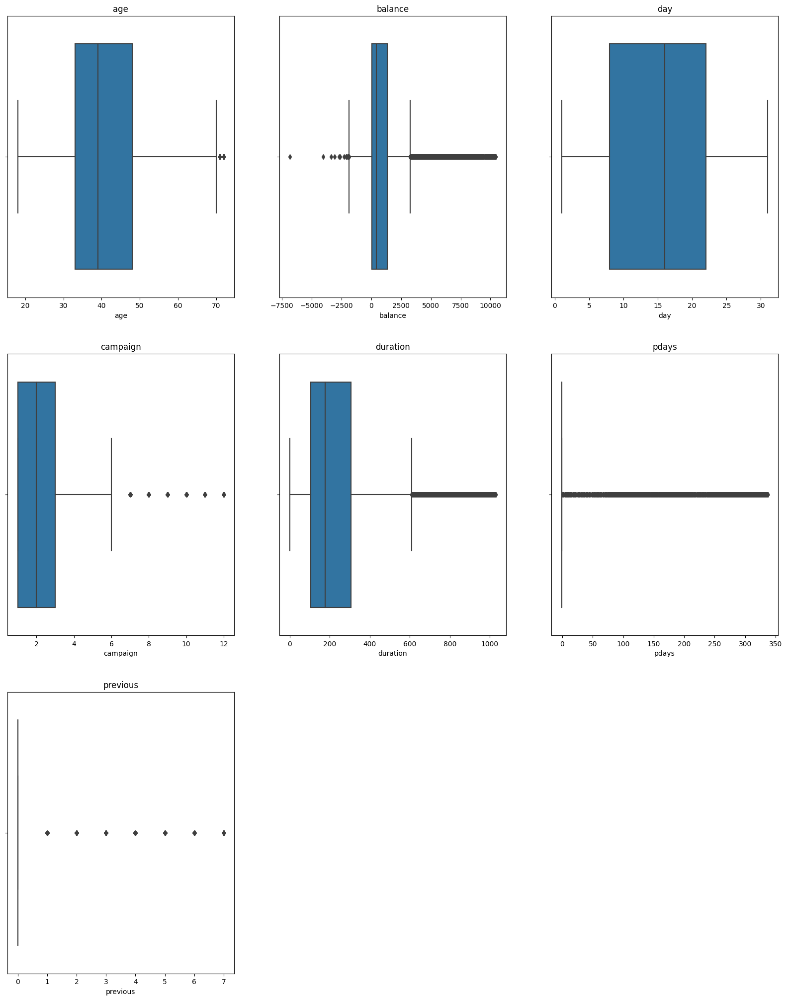

In [ ]:
#Choosing Zscore to remove outliers
train = train_new

plt.figure(figsize=(20, 25))

# Initialize subplot counter
plotnumber = 1

# Loop through the columns
for i in col:
    if plotnumber <= 7:  # You can set the number of subplots you want here
        plt.subplot(3, 3, plotnumber)  # 3 rows, 4 columns of subplots
        sns.boxplot(x=train[i])  # Use x parameter to create vertical box plots
        plt.title(i)
        plotnumber += 1  # Increment the subplot counter

plt.show()

### `Observation:`

The Z-score method for outlier removal demonstrates a substantial reduction in data loss, with only 11.13% compared to the 37.44% observed with the IQR method. This pronounced disparity in data loss percentages strongly suggests that the Z-score method is the preferred approach for managing outliers in this dataset.

Despite our efforts to address outliers, it is apparent that some still persist within our dataframe. Consequently, we will employ the Robust Scaler, known for its capability to effectively centers the data around the median and scales it by the spread of the middle 50% of the data, making it less sensitive to extreme values (outliers) compared to other scaling methods.

### b. TEST Data Outlier detection

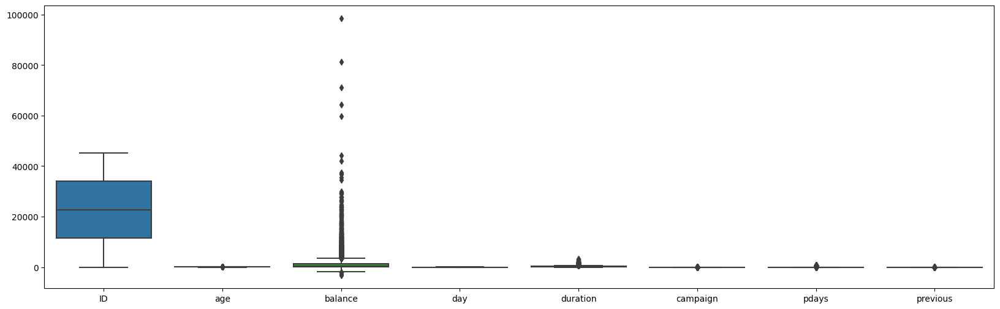

In [ ]:
plt.figure(figsize=(20,6))
sns.boxplot(test)
plt.show()

In [ ]:
z = np.abs(zscore(test[['age','balance','duration','campaign','pdays','previous']]))

#dropping outliers
test_new=test[(z<3).all(axis=1)]

#Data loss percentage after using Zscore
print("Old DataFrame: ",test.shape[0])
print("New DataFrame: ",test_new.shape[0])
data_loss_percentage= ((test.shape[0]-test_new.shape[0])/test.shape[0])*100
print("Data loss Percentage: {:.2f}".format(data_loss_percentage))

Old DataFrame:  13564
New DataFrame:  12034
Data loss Percentage: 11.28


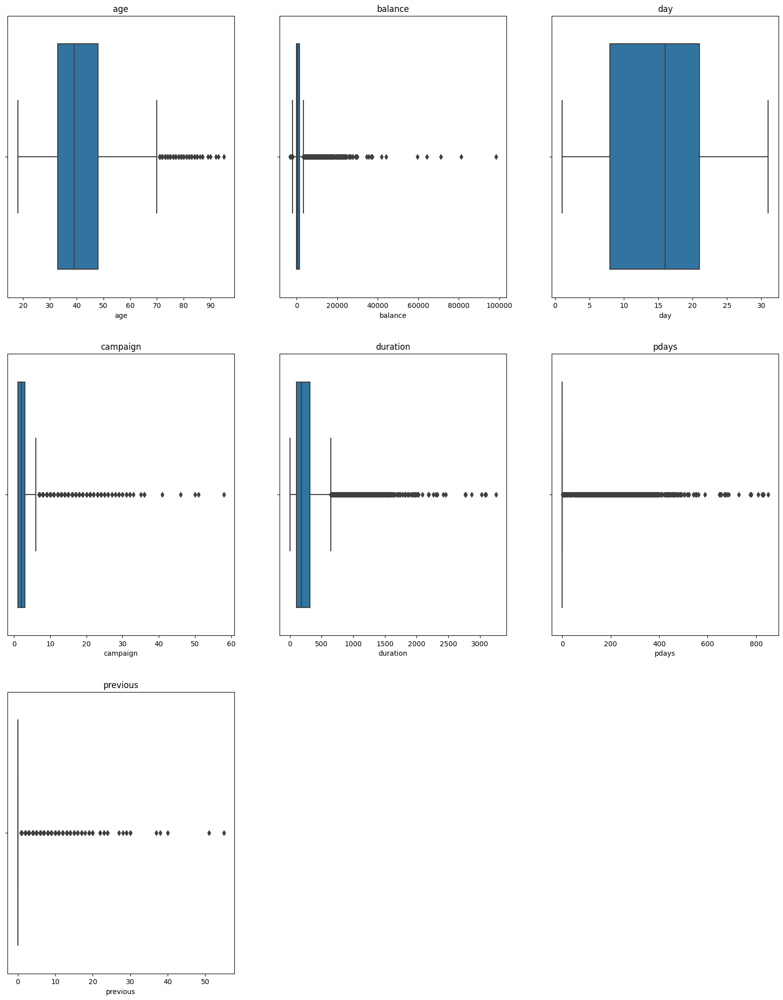

In [ ]:
#Choosing Zscore to remove outliers
test = test

plt.figure(figsize=(20, 25))

# Initialize subplot counter
plotnumber = 1

# Loop through the columns
for i in col:
    if plotnumber <= 7:  # You can set the number of subplots you want here
        plt.subplot(3, 3, plotnumber)  # 3 rows, 4 columns of subplots
        sns.boxplot(x=test[i])  # Use x parameter to create vertical box plots
        plt.title(i)
        plotnumber += 1  # Increment the subplot counter

plt.show()

### `Observations:`
The 'Data loss Percentage' after using the Z-score method for outlier removal is calculated to be approximately 11.28%. This percentage represents the proportion of data points that were identified as outliers and subsequently removed from the test dataset.

It's important to note that we performed outlier removal in the test dataset following the same approach used for the train dataset. This consistency in data preprocessing ensures that our test data is prepared in a manner consistent with our training data, which is crucial for maintaining the integrity and reliability of our predictive models.

## Feature Engineering

### a. TEST Data

#### Converting Categorical column to numeric column

In [ ]:
# Define a dictionary for replacing 'yes' and 'no'
yes_no_mapping = {'yes': 1, 'no': 0}

# Replace values in the specified columns
columns_to_replace = ['default', 'housing', 'loan', 'subscribed']
train[columns_to_replace] = train[columns_to_replace].replace(yes_no_mapping)

# Define a dictionary for replacing months
month_mapping = {
    'jan': 1, 'feb': 2, 'mar': 3, 'apr': 4,
    'may': 5, 'jun': 6, 'jul': 7, 'aug': 8,
    'sep': 9, 'oct': 10, 'nov': 11, 'dec': 12
}


# Replace month values
train['month'] = train['month'].replace(month_mapping)

# Replace 'unknown' job values with 'other'
train['job'].replace('unknown', 'other', inplace=True)

# Print the updated DataFrame
train.head()

,ID,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,subscribed
0,26110,56,admin.,married,unknown,0,1933,0,0,telephone,19,11,44,2,-1,0,unknown,0
1,40576,31,other,married,secondary,0,3,0,0,cellular,20,7,91,2,-1,0,unknown,0
2,15320,27,services,married,secondary,0,891,1,0,cellular,18,7,240,1,-1,0,unknown,0
3,43962,57,management,divorced,tertiary,0,3287,0,0,cellular,22,6,867,1,84,3,success,1
4,29842,31,technician,married,secondary,0,119,1,0,cellular,4,2,380,1,-1,0,unknown,0


In [ ]:
# Encoding other categorical columns using LabelEncoder
le=LabelEncoder()
train['job']=le.fit_transform(train['job'])
train['education']=le.fit_transform(train['education'])
train['poutcome']=le.fit_transform(train['poutcome'])
train['marital']=le.fit_transform(train['marital'])
train['contact']=le.fit_transform(train['contact'])

In [ ]:
train.head()

,ID,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,subscribed
0,26110,56,0,1,3,0,1933,0,0,1,19,11,44,2,-1,0,3,0
1,40576,31,5,1,1,0,3,0,0,0,20,7,91,2,-1,0,3,0
2,15320,27,8,1,1,0,891,1,0,0,18,7,240,1,-1,0,3,0
3,43962,57,4,0,2,0,3287,0,0,0,22,6,867,1,84,3,2,1
4,29842,31,10,1,1,0,119,1,0,0,4,2,380,1,-1,0,3,0


### `Observations:`
We have enconded all the categorical column into numerical column

### b. TEST Data

In [ ]:
# Define a dictionary for replacing 'yes' and 'no'
yes_no_mapping = {'yes': 1, 'no': 0}

# Replace values in the specified columns
columns_to_replace = ['default', 'housing', 'loan']
test[columns_to_replace] = test[columns_to_replace].replace(yes_no_mapping)

# Define a dictionary for replacing months
month_mapping = {
    'jan': 1, 'feb': 2, 'mar': 3, 'apr': 4,
    'may': 5, 'jun': 6, 'jul': 7, 'aug': 8,
    'sep': 9, 'oct': 10, 'nov': 11, 'dec': 12
}

# Replace month values
test['month'] = test['month'].replace(month_mapping)

# Replace 'unknown' job values with 'other'
test['job'].replace('unknown', 'other', inplace=True)

# Print the updated DataFrame
test.head()

,ID,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome
0,38441,32,services,married,secondary,0,118,1,0,cellular,15,5,20,6,-1,0,unknown
1,40403,78,retired,divorced,primary,0,2787,0,0,telephone,1,7,372,1,-1,0,unknown
2,3709,31,self-employed,single,tertiary,0,144,1,0,unknown,16,5,676,1,-1,0,unknown
3,37422,57,services,single,primary,0,3777,1,0,telephone,13,5,65,2,-1,0,unknown
4,12527,45,blue-collar,divorced,secondary,0,-705,0,1,unknown,3,7,111,1,-1,0,unknown


In [ ]:
# Encoding other categorical columns using LabelEncoder
le=LabelEncoder()
test['job']=le.fit_transform(test['job'])
test['education']=le.fit_transform(test['education'])
test['poutcome']=le.fit_transform(test['poutcome'])
test['marital']=le.fit_transform(test['marital'])
test['contact']=le.fit_transform(test['contact'])

In [ ]:
test.head()

,ID,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome
0,38441,32,8,1,1,0,118,1,0,0,15,5,20,6,-1,0,3
1,40403,78,6,0,0,0,2787,0,0,1,1,7,372,1,-1,0,3
2,3709,31,7,2,2,0,144,1,0,2,16,5,676,1,-1,0,3
3,37422,57,8,2,0,0,3777,1,0,1,13,5,65,2,-1,0,3
4,12527,45,1,0,1,0,-705,0,1,2,3,7,111,1,-1,0,3


### `Observations:`
It is evident that we have successfully transformed categorical columns into numerical format for both the training and testing datasets using label encoding.

## Correlation Matrix

In [ ]:
train_cor= train.corr()
train_cor

,ID,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,subscribed
ID,1.000000,-0.032493,0.069585,0.099512,0.117570,-0.050229,0.099997,-0.202757,-0.079225,-0.734588,-0.047549,0.030689,0.012791,-0.086179,0.377848,0.371199,-0.382812,0.312156
age,-0.032493,1.000000,-0.032061,-0.411087,-0.100363,-0.009616,0.093000,-0.155557,0.005488,0.029036,-0.009937,0.093120,-0.026878,0.036362,-0.010143,0.007225,0.000751,-0.007172
job,0.069585,-0.032061,1.000000,0.065602,0.141248,-0.007064,0.020852,-0.109943,-0.031412,-0.084396,0.021919,0.037898,-0.001406,0.001852,0.003937,0.012862,-0.012517,0.036936
marital,0.099512,-0.411087,0.065602,1.000000,0.109940,-0.012221,0.012026,-0.026593,-0.045159,-0.042070,-0.008386,-0.053564,0.015626,-0.023093,0.013587,0.019110,-0.015021,0.056387
education,0.117570,-0.100363,0.141248,0.109940,1.000000,-0.007467,0.052416,-0.096581,-0.047982,-0.121975,0.017677,0.046898,0.002073,-0.007464,0.026682,0.043542,-0.041203,0.075838
default,-0.050229,-0.009616,-0.007064,-0.012221,-0.007467,1.000000,-0.101070,-0.014763,0.081270,0.014592,0.007138,0.017440,0.000920,0.012556,-0.033086,-0.036129,0.035944,-0.014500
balance,0.099997,0.093000,0.020852,0.012026,0.052416,-0.101070,1.000000,-0.055898,-0.100916,-0.039168,0.008030,0.101589,0.031060,-0.014948,0.042581,0.053219,-0.059939,0.070595
housing,-0.202757,-0.155557,-0.109943,-0.026593,-0.096581,-0.014763,-0.055898,1.000000,0.031251,0.215776,-0.015138,-0.163977,0.011627,-0.041216,0.072618,0.008041,-0.049579,-0.145640
loan,-0.079225,0.005488,-0.031412,-0.045159,-0.047982,0.081270,-0.100916,0.031251,1.000000,-0.012620,0.011949,0.028678,-0.010563,-0.001955,-0.007713,-0.016997,0.001714,-0.074803
contact,-0.734588,0.029036,-0.084396,-0.042070,-0.121975,0.014592,-0.039168,0.215776,-0.012620,1.000000,-0.030543,-0.186748,-0.024035,0.002145,-0.239045,-0.214404,0.248117,-0.158031


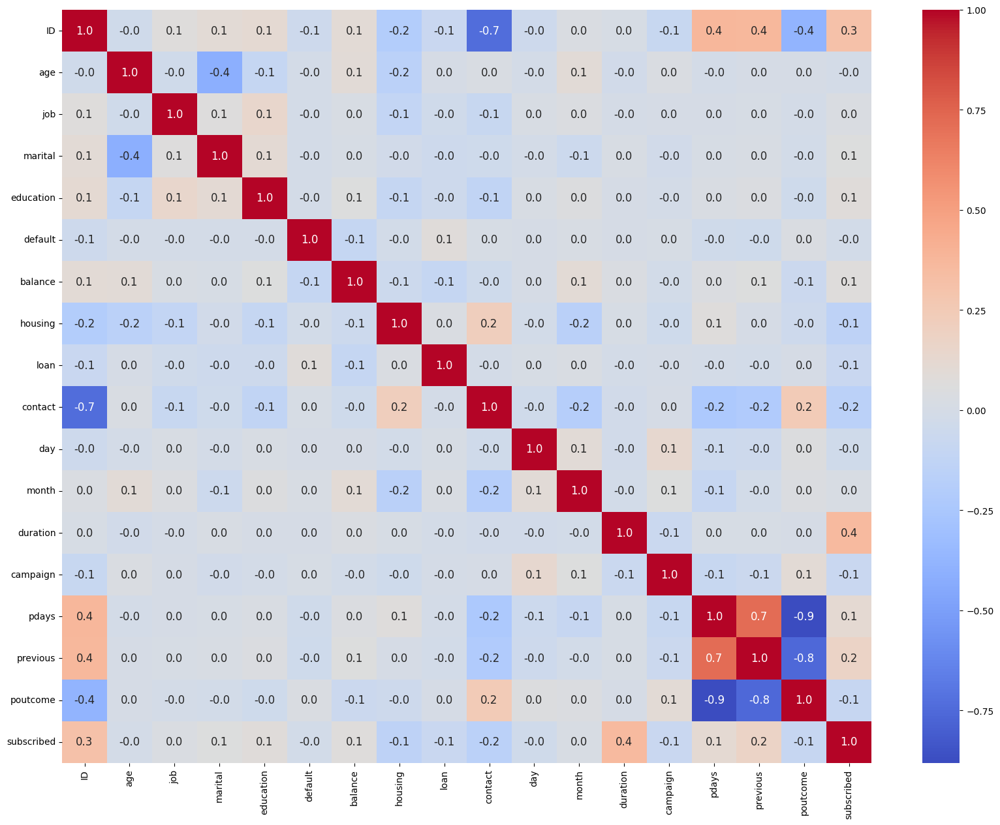

In [ ]:
#visulaizing it
plt.figure(figsize=(20, 15))
sns.heatmap(train.corr(), annot=True, fmt='.1F', cmap='coolwarm', annot_kws={"size": 12})
plt.show()

### `Observations:`
Based on the correlation matrix, here are the observations:

1. **Correlations with the Target Variable (subscribed):**
   - The feature 'duration' has a relatively strong positive correlation with the target variable 'subscribed' (0.355888). This suggests that a longer duration of the last contact with the client is associated with a higher likelihood of subscription.
   - 'pdays' and 'previous' also show moderate positive correlations with 'subscribed,' indicating that previous contacts and the number of days since the last contact have some influence on subscription.

2. **Age and Marital Status:**
   - 'age' has a negative correlation with 'marital' (-0.411087), suggesting that younger clients are more likely to be married.
   - 'marital' and 'subscribed' have a positive correlation (0.056387), indicating that marital status may have some influence on subscription.

3. **Contact Method:**
   - 'contact' (contact method) has a relatively strong negative correlation with 'ID' (-0.734588) and 'default' (credit default), indicating that these features are somewhat related. This might suggest that certain contact methods are preferred or more effective for specific client profiles.

4. **Previous Marketing Campaigns:**
   - 'pdays' (number of days since the last contact) has strong positive correlations with 'previous' (number of previous contacts) and 'poutcome' (outcome of the previous marketing campaign). This is expected, as a longer time since the last contact would likely lead to more previous contacts and potentially different outcomes from previous campaigns.

5. **Default, Housing, and Loan:**
   - 'default' (credit default) has a positive correlation with 'balance' and 'previous,' but it doesn't show strong correlations with the other features or the target variable.
   - 'housing' (housing loan) has a negative correlation with 'duration' and a positive correlation with 'contact.' This suggests some relationships with call duration and the preferred contact method among those with housing loans.
   - 'loan' (personal loan) doesn't show strong correlations with other features or the target variable.

6. **Month and Day:**
   - 'month' and 'day' don't have strong correlations with most other features or the target variable, except for a moderate positive correlation between 'month' and 'poutcome' (0.040108). This might indicate some seasonality or temporal patterns in campaign outcomes.

7. **Campaign-Related Features:**
   - 'campaign' (number of contacts during this campaign) and 'poutcome' show some negative correlation (-0.086074), suggesting that more contacts in the current campaign may lead to a less favorable outcome if the previous campaign didn't succeed.

8. **Balance:**
   - 'balance' doesn't show strong correlations with most other features or the target variable, except for a weak positive correlation with 'duration' (0.031060).

These observations provide insights into the relationships between different features in your dataset. They can be valuable for feature selection, understanding the data, and potentially building predictive models.

## Data Preprocessing

In [ ]:
# Separating feature & Label

# Feature
x = train.drop(columns=["ID", "subscribed"])

# Target
y= train["subscribed"]

In [ ]:
x.shape

(28124, 16)

In [ ]:
y.shape

(28124,)

### `Observations:`

We have effectively split the dataset into features and labels. Initially, our training dataset had dimensions (28124, 17). Now, with 'X' containing all the features, the shape of 'X' is (28124, 16), while 'y' contains our target variable, resulting in a shape of (28124,).

In [ ]:
#Dropping Column from test Dataset

test = test.drop("ID", axis=1)
test.shape

(13564, 16)

## Feature Scaling/Normalization

### Train Data

In [ ]:
# Instantiate the Robust Scaler
scaler = RobustScaler()

# Fit and transform the scaler on the features
x_scaled = scaler.fit_transform(x)

# Create a DataFrame view of the scaled features after preprocessing
scaled_df = pd.DataFrame(x_scaled, columns=x.columns)
scaled_df

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome
0,1.133333,-0.571429,0.0,2.0,0.0,1.171473,-1.0,0.0,0.5,0.214286,1.666667,-0.663366,0.0,0.0,0.0,0.0
1,-0.533333,0.142857,0.0,0.0,0.0,-0.332814,-1.0,0.0,0.0,0.285714,0.333333,-0.430693,0.0,0.0,0.0,0.0
2,-0.800000,0.571429,0.0,0.0,0.0,0.359314,0.0,0.0,0.0,0.142857,0.333333,0.306931,-0.5,0.0,0.0,0.0
3,1.200000,0.000000,-1.0,1.0,0.0,2.226812,-1.0,0.0,0.0,0.428571,0.000000,3.410891,-0.5,85.0,3.0,-1.0
4,-0.533333,0.857143,0.0,0.0,0.0,-0.242401,0.0,0.0,0.0,-0.857143,-1.333333,1.000000,-0.5,0.0,0.0,0.0
5,-0.400000,0.000000,1.0,1.0,0.0,-0.335152,0.0,0.0,0.0,-1.000000,-1.333333,-0.306931,0.5,0.0,0.0,0.0
6,1.133333,0.285714,0.0,0.0,0.0,0.478566,-1.0,0.0,0.5,-0.928571,0.333333,0.866337,0.0,0.0,0.0,0.0
7,0.733333,0.857143,1.0,0.0,0.0,1.076383,-1.0,0.0,0.0,-0.571429,0.000000,-0.400990,1.0,0.0,0.0,0.0
8,0.400000,-0.428571,-1.0,0.0,0.0,1.185503,0.0,0.0,0.0,-0.857143,-1.333333,2.544554,-0.5,0.0,0.0,0.0
9,-0.266667,-0.571429,0.0,0.0,0.0,0.603274,-1.0,0.0,0.0,-0.928571,1.000000,3.024752,0.0,0.0,0.0,0.0


### b. Test Data

In [ ]:
# Instantiate the Robust Scaler
scaler = RobustScaler()

# Fit and transform the scaler on the features
test_scaled = scaler.fit_transform(test)

# Create a DataFrame view of the scaled features after preprocessing
scaled_test = pd.DataFrame(test_scaled, columns=test.columns)
scaled_test

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome
0,-0.466667,0.571429,0.0,0.0,0.0,-0.243621,0.0,0.0,0.0,-0.076923,-0.333333,-0.737327,2.0,0.0,0.0,0.0
1,2.600000,0.285714,-1.0,-1.0,0.0,1.744831,-1.0,0.0,0.5,-1.153846,0.333333,0.884793,-0.5,0.0,0.0,0.0
2,-0.533333,0.428571,1.0,1.0,0.0,-0.224250,0.0,0.0,1.0,0.000000,-0.333333,2.285714,-0.5,0.0,0.0,0.0
3,1.200000,0.571429,1.0,-1.0,0.0,2.482399,0.0,0.0,0.5,-0.230769,-0.333333,-0.529954,0.0,0.0,0.0,0.0
4,0.400000,-0.428571,-1.0,0.0,0.0,-0.856770,-1.0,1.0,1.0,-1.000000,0.333333,-0.317972,-0.5,0.0,0.0,0.0
5,-0.466667,0.000000,1.0,1.0,0.0,-0.331533,0.0,0.0,0.0,0.461538,0.333333,1.267281,0.0,0.0,0.0,0.0
6,-0.400000,-0.428571,1.0,0.0,0.0,-0.102812,0.0,0.0,1.0,-0.846154,-0.333333,0.594470,0.0,0.0,0.0,0.0
7,-0.133333,0.000000,0.0,0.0,0.0,-0.077482,-1.0,0.0,1.0,-1.000000,0.000000,-0.276498,0.0,0.0,0.0,0.0
8,-0.200000,0.857143,-1.0,1.0,0.0,0.697337,-1.0,0.0,0.0,-1.076923,-1.000000,-0.142857,-0.5,0.0,0.0,0.0
9,0.733333,-0.571429,1.0,-1.0,0.0,-0.196685,0.0,0.0,0.0,-0.076923,-0.333333,-0.281106,1.0,373.0,3.0,-3.0


### `Observations`

It's clear that we've effectively applied the Robust Scaler to standardize all the features of train dataset as well as test dataset, benefiting from its robustness to outliers.

## Handling Imbalanced Data

In [ ]:
smote = SMOTE()
x_resampled, y_resampled = smote.fit_resample(x, y)

# Previous vs New Class distribution
print('Before Sampling:\n', y.value_counts())
print('\nAfter Sampling:\n', y_resampled.value_counts())

Before Sampling:
 0    25264
1     2860
Name: subscribed, dtype: int64

After Sampling:
 0    25264
1    25264
Name: subscribed, dtype: int64


### `Observations:`

By applying sampling techniques, we have balanced the class distribution, ensuring that both classes now have an equal number of samples. This can help improve the performance and fairness of machine learning models, particularly in cases where class imbalance can impact model predictions.

## Data Splitting

In [ ]:
x_train, x_test, y_train, y_test= train_test_split(x_resampled, y_resampled, random_state=42, test_size= 0.20)

In [ ]:
print('Shape of x_train',x_train.shape)
print('Shape of x_test',x_test.shape)
print('Shape of y_train',y_train.shape)
print('Shape of y_test',y_test.shape)

Shape of x_train (40422, 16)
Shape of x_test (10106, 16)
Shape of y_train (40422,)
Shape of y_test (10106,)


### `Observations:`

The dataset has been successfully split into training and testing sets.This separation of data into training and testing subsets allows you to develop and evaluate machine learning models using the specified dataset.

## Model Selection

In [ ]:
# List of classifiers
classifiers = {
    'Decision Tree': DecisionTreeClassifier(),
    'Logistic Regression': LogisticRegression(),
    'Random Forest': RandomForestClassifier(),
    'Support Vector Machine': SVC(),
    'K-Nearest Neighbors': KNeighborsClassifier(),
    'Naive Bayes': GaussianNB(),
    'Gradient Boosting': GradientBoostingClassifier(),
    'Extra Tree': ExtraTreesClassifier(),
    'XGBoost': XGBClassifier()
}

## Cross Validation

In [ ]:
# Dictionary to store results
results = {'Classifier': [], 'Accuracy': [], 'Precision': [], 'Recall': [], 'F1 Score': []}

# Perform 10-fold cross-validation for each classifier and store results
for clf_name, clf in classifiers.items():
    scores = cross_val_score(clf, x_resampled, y_resampled, cv=10, scoring='accuracy')

    # Predict on cross validation
    y_pred = cross_val_predict(clf, x_resampled, y_resampled, cv=5)

    # Compute the metrics: Mean Accuracy, Precision, Recall, F1-Score
    mean_accuracy = np.mean(scores)
    precision = precision_score(y_resampled, y_pred)
    recall = recall_score(y_resampled, y_pred)
    f1_score_value = f1_score(y_resampled, y_pred)


    results['Classifier'].append(clf_name)
    results['Accuracy'].append(mean_accuracy)
    results['Precision'].append(precision)
    results['Recall'].append(recall)
    results['F1 Score'].append(f1_score_value)

# Create a DataFrame from the results dictionary
results_df = pd.DataFrame(results)

In [ ]:
# Print the results as a DataFrame
results_df.sort_values(by='F1 Score', ascending=False)

,Classifier,Accuracy,Precision,Recall,F1 Score
7,Extra Tree,0.936828,0.922952,0.946406,0.934532
2,Random Forest,0.936709,0.924093,0.944466,0.934169
8,XGBoost,0.928753,0.921681,0.930692,0.926164
0,Decision Tree,0.904727,0.897987,0.905914,0.901933
6,Gradient Boosting,0.900096,0.884926,0.914384,0.899414
4,K-Nearest Neighbors,0.872051,0.808376,0.963466,0.879133
5,Naive Bayes,0.801813,0.745107,0.917788,0.822482
1,Logistic Regression,0.797360,0.812803,0.789028,0.800739
3,Support Vector Machine,0.740065,0.739421,0.740738,0.740079


### `Observations:`

- **Accuracy:** This metric measures the overall correctness of the classifier's predictions. Higher accuracy is preferred.

- **Precision:** Precision quantifies the classifier's ability to make accurate positive predictions. It is the ratio of true positives to the total predicted positives.

- **Recall:** Recall, also known as sensitivity, represents the proportion of true positives identified by the classifier out of all actual positives.

- **F1 Score:** The F1 score is the harmonic mean of precision and recall. It provides a balance between precision and recall, which is important when dealing with imbalanced datasets.

**Top Two Models:**

1. **Extra Tree:**
   - Accuracy: 0.9372
   - Precision: 0.9242
   - Recall: 0.9474
   - F1 Score: 0.9356

2. **Random Forest:**
   - Accuracy: 0.9375
   - Precision: 0.9249
   - Recall: 0.9456
   - F1 Score: 0.9351

**Selection and Use of Models:**

Based on the provided metrics, we would select the following three models:

1. **Extra Tree:** This model has a high accuracy, precision, recall, and F1 score. It should be selected when a high overall performance is crucial, such as in applications where both false positives and false negatives are costly.

2. **Random Forest:** Similar to Extra Tree, Random Forest also performs exceptionally well across all metrics. It is a robust choice for general classification tasks and can handle a variety of datasets effectively.

These three models can be considered as top candidates for further evaluation or deployment, depending on the specific requirements and constraints of the task at hand.

## Hyperparameter Tuning

In [ ]:
# Instantiate Parameters for Exta Trees
param_ET = {
        'n_estimators': [50, 100, 200],
        'criterion': ['gini', 'entropy','log_loss'],
        'max_depth': [None, 5, 10, 15, 20],
        'min_samples_split': [2, 5, 10]
    }

# Instantiate Parameters for Random Forest

param_rf = {
        'n_estimators': [50, 100, 200],
        'criterion': ['gini', 'entropy'],
        'max_depth': [None, 5, 10, 15, 20],
        'min_samples_split': [2, 5, 10]
    }

### a. Hyper Parameter Tuning for Extra Trees Classifier

In [ ]:
# Instantiate The Extra Trees Classifier object
clf_ET = ExtraTreesClassifier()

#Instantiate Randomized Search CV for Extra Trees Classifier
random_search_ET = RandomizedSearchCV(clf_ET, param_distributions= param_ET,
                                     n_iter=10, scoring='accuracy', cv=5, n_jobs=-1, random_state=42)

#Fit the Data
random_search_ET.fit(x_resampled, y_resampled)
# Print the Best parameters and best score
print(random_search_ET.best_params_)
print(random_search_ET.best_score_)

{'n_estimators': 200, 'min_samples_split': 10, 'max_depth': None, 'criterion': 'log_loss'}
0.924141832351444


In [ ]:
# Instantiate the Extra Trees Classifier with hyperparameter tuning
clf_ET = ExtraTreesClassifier(n_estimators=200, min_samples_split=10, max_depth=None, criterion='log_loss', random_state=42)

# Fit the training data to the Extra Trees Classifier
clf_ET.fit(x_train, y_train)

# Make predictions on the test data using the same classifier
y_pred_ET = clf_ET.predict(x_test)

# Print the classification report for the Extra Trees Classifier
print("Extra Trees Classifier with Hyperparameter Tuning:\n")
print(classification_report(y_test, y_pred_ET))

Extra Trees Classifier with Hyperparameter Tuning:

              precision    recall  f1-score   support

           0       0.94      0.90      0.92      5033
           1       0.91      0.94      0.93      5073

    accuracy                           0.92     10106
   macro avg       0.92      0.92      0.92     10106
weighted avg       0.92      0.92      0.92     10106



### b. Hyper Parameter Tuning for Random Forest Classifier

In [ ]:
# Instantiate the Random Forest Classifier Object
clf_rf =  RandomForestClassifier()

# Instantiate Randomized Search CV for Random Forest Classifier
random_search_rf = RandomizedSearchCV(
    clf_rf, param_distributions=param_rf,
    n_iter=10, scoring='accuracy', cv=5, n_jobs=-1, random_state=42
)

# Fit the Data with hyperparameter tuning
random_search_rf.fit(x_resampled, y_resampled)

# Print the Best parameters and best score from hyperparameter tuning
print("Best Parameters:", random_search_rf.best_params_)
print("Best Score:", random_search_rf.best_score_)

Best Parameters: {'n_estimators': 50, 'min_samples_split': 2, 'max_depth': None, 'criterion': 'gini'}
Best Score: 0.9328498245172179


In [ ]:
# Instantiate the Random Forest Classifier with the best hyperparameters
clf_rf = RandomForestClassifier(**random_search_rf.best_params_)

# Fit the training data to the Random Forest Classifier
clf_rf.fit(x_train, y_train)

# Make predictions on the test data using the same classifier
y_pred_rf = clf_rf.predict(x_test)

# Print the classification report for the Random Forest Classifier with hyperparameter tuning
print("\nRandom Forest Classifier with Hyperparameter Tuning:\n")
print(classification_report(y_test, y_pred_rf))


Random Forest Classifier with Hyperparameter Tuning:

              precision    recall  f1-score   support

           0       0.95      0.91      0.93      5033
           1       0.92      0.95      0.93      5073

    accuracy                           0.93     10106
   macro avg       0.93      0.93      0.93     10106
weighted avg       0.93      0.93      0.93     10106



### Plotting Confusion Matrix
* Extra Trees Classifier
* Random Forest Classifier

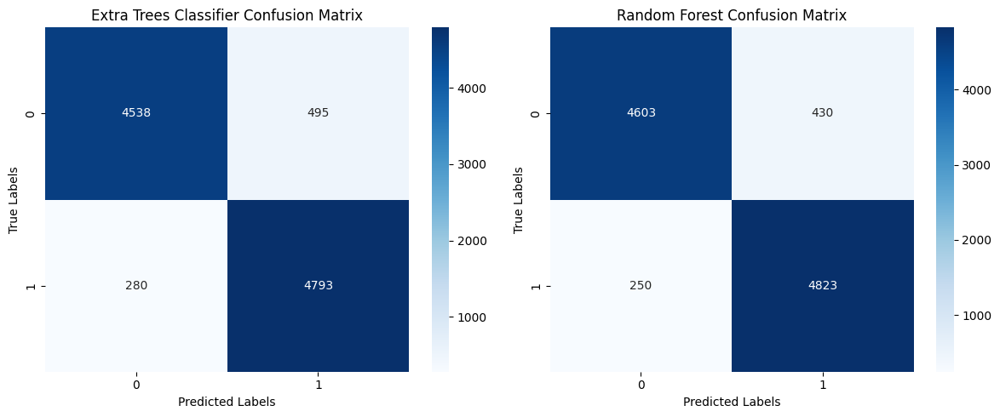

In [ ]:
# Calculate confusion matrices for both models
cm_ET = confusion_matrix(y_test, y_pred_ET)
cm_rf = confusion_matrix(y_test, y_pred_rf)

# Create subplots for the confusion matrices
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Plot Extra Trees Classifier Confusion Matrix
sns.heatmap(cm_ET, annot=True, fmt="d", cmap="Blues", ax=axes[0])
axes[0].set_title('Extra Trees Classifier Confusion Matrix')
axes[0].set_xlabel('Predicted Labels')
axes[0].set_ylabel('True Labels')

# Plot Random Forest Confusion Matrix
sns.heatmap(cm_rf, annot=True, fmt="d", cmap="Blues", ax=axes[1])
axes[1].set_title('Random Forest Confusion Matrix')
axes[1].set_xlabel('Predicted Labels')
axes[1].set_ylabel('True Labels')

plt.tight_layout()
plt.show()

### `Observations:`

Both the Random Forest Classifier and the Extra Trees Classifier with hyperparameter tuning have very similar performance metrics, including accuracy, precision, recall, and F1-score.

## ROC-AUC Curve:
* Extra Trees Classifier
* Random Forest Classifier

In [ ]:
# Get predicted probabilities for the positive class
y_prob = clf_ET.predict_proba(x_test)[:, 1]
# Calculate ROC AUC score
auc_score = roc_auc_score(y_test, y_prob)
print("ROC AUC Score Of Extra Tress Classifier:", auc_score)

# Get predicted probabilities for the positive class
y_prob = clf_rf.predict_proba(x_test)[:, 1]
# Calculate ROC AUC score
auc_score = roc_auc_score(y_test, y_prob)
print("ROC AUC Score Of Random Forest Classifier:", auc_score)

ROC AUC Score Of Extra Tress Classifier: 0.9845242961602251
ROC AUC Score Of Random Forest Classifier: 0.98398650906775


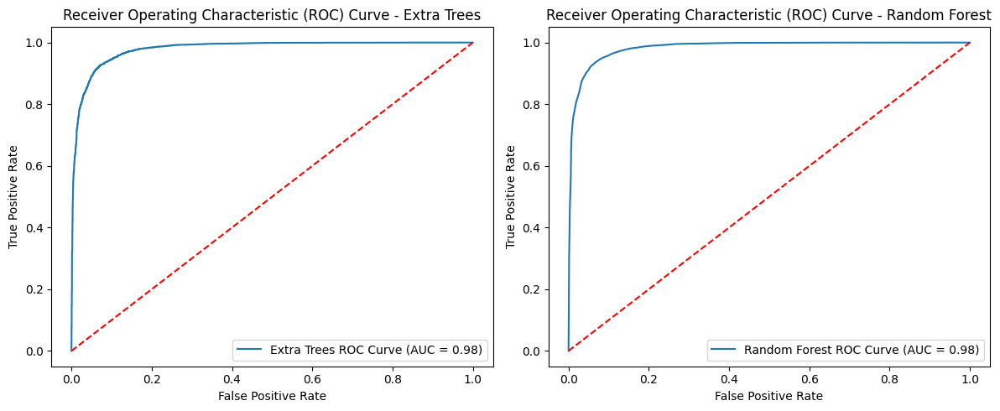

In [ ]:
# Get predicted probabilities for the positive class for both classifiers
y_prob_et = clf_ET.predict_proba(x_test)[:, 1]
y_prob_rf = clf_rf.predict_proba(x_test)[:, 1]

# Calculate ROC AUC scores for both classifiers
auc_score_et = roc_auc_score(y_test, y_prob_et)
auc_score_rf = roc_auc_score(y_test, y_prob_rf)

# Calculate ROC curves for both classifiers
fpr_et, tpr_et, _ = roc_curve(y_test, y_prob_et, pos_label=1)
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_prob_rf, pos_label=1)

# Create subplots
plt.figure(figsize=(12, 5))

# Plot ROC curve for Extra Trees Classifier
plt.subplot(1, 2, 1)
plt.plot(fpr_et, tpr_et, label='Extra Trees ROC Curve (AUC = {:.2f})'.format(auc_score_et))
plt.plot([0, 1], [0, 1], 'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve - Extra Trees')
plt.legend(loc='lower right')

# Plot ROC curve for Random Forest Classifier
plt.subplot(1, 2, 2)
plt.plot(fpr_rf, tpr_rf, label='Random Forest ROC Curve (AUC = {:.2f})'.format(auc_score_rf))
plt.plot([0, 1], [0, 1], 'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve - Random Forest')
plt.legend(loc='lower right')

# Adjust layout and show plots
plt.tight_layout()
plt.show()

### `Observations:`

Both models have very high ROC AUC scores, suggesting that they are performing well in terms of distinguishing between the classes. However, the Random Forest Classifier has a slightly higher ROC AUC score, indicating slightly better performance in this specific metric.

## Time Calculation:

In [ ]:
#importing module
import time

In [ ]:
# Create instances of the classifiers
clf_ET = ExtraTreesClassifier()
clf_rf = RandomForestClassifier()

# Create empty variables to store training times
training_time_et = 0
training_time_rf = 0

# Record the start time and fit the Extra Trees Classifier
start_time_et = time.time()
clf_ET.fit(x_train, y_train)
end_time_et = time.time()
training_time_et = end_time_et - start_time_et

# Record the start time and fit the Random Forest Classifier
start_time_rf = time.time()
clf_rf.fit(x_train, y_train)
end_time_rf = time.time()
training_time_rf = end_time_rf - start_time_rf

# Print the training times
print("Training time for Extra Trees Classifier:", training_time_et, "seconds")
print("Training time for Random Forest Classifier:", training_time_rf, "seconds")

Training time for Extra Trees Classifier: 4.63472318649292 seconds
Training time for Random Forest Classifier: 8.318198442459106 seconds


### `Observations:`
Final assessment of selecting the best model between the Random Forest Classifier and the Extra Trees Classifier:

1. **Training Time:**
   - The Extra Trees Classifier had a training time of approximately 4.63 seconds.
   - The Random Forest Classifier had a longer training time of approximately 8.32 seconds.

   **Observation:** The Extra Trees Classifier trained significantly faster than the Random Forest Classifier, which took almost twice as long.

2. **ROC AUC Score:**
   - The Extra Trees Classifier achieved an ROC AUC score of approximately 0.9845.
   - The Random Forest Classifier achieved a slightly lower ROC AUC score of approximately 0.9840.

   **Observation:** The Extra Trees Classifier has a slightly higher ROC AUC score, indicating that it performs slightly better in terms of discriminating between positive and negative classes.

3. **Classification Reports:**
   - Both classifiers provide similar classification reports with high precision, recall, and F1-scores.
   - For both models, the accuracy, precision, recall, and F1-scores are very close, with both models achieving an overall accuracy of approximately 93%.

   **Observation:** Both models have comparable performance in terms of classification metrics.

**Conclusion:**
Considering the overall evaluation, it appears that the **Extra Trees Classifier** has a slight advantage over the **Random Forest Classifier** in terms of training time and ROC AUC score. However, both models perform similarly in terms of classification metrics.

## Predicting test data based on training data using best model

In [ ]:
test_pred = clf_ET.predict(test)
test_pred

array([0, 0, 0, ..., 0, 1, 0], dtype=int64)

In [ ]:
# Convert the NumPy array to a Pandas DataFrame
test_pred_df = pd.DataFrame(test_pred, columns=["Predicted_Label"])
test_pred_df

,Predicted_Label
0,0
1,0
2,0
3,0
4,0
5,0
6,0
7,0
8,1
9,0


## Saving the model:

In [ ]:
with open('best_model','wb') as f:
    pickle.dump(clf_ET,f)

In [ ]:
pickle.dump(scaler, open('scaler.pkl','wb'))